### Puram et al Cell
- Puram et al., 2017, Cell 171, 1611–1624, https://doi.org/10.1016/j.cell.2017.10.044
- GEO: GSE103322
- Head and neck squamous cell carcinoma (HNSCC), 5902 single cells from 18 patients
- whole transcript
- Smart-seq2

In [1]:
import os
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
from matplotlib import rcParams
import seaborn as sns
import anndata as an
# import scanorama
from scipy.sparse import csr_matrix
from deside.single_cell import get_10x_mtx, normalize_mtx
sns.set()

### 1. Read an filtering raw data

In [2]:
file_path = r'F:\projects\001EMT-infiltration\raw_data\single cells\Puram et al Cell'
result_dir = os.path.join(file_path, 'preprocessing')

In [3]:
tpm = pd.read_csv(os.path.join(file_path, 'hnscc_sc_tpm.csv'), index_col=0)
tpm = tpm.T
print(tpm.shape)
tpm.head(2)

(5902, 23686)


gene_name,C9orf152,RPS11,ELMO2,CREB3L1,PNMA1,MMP2,TMEM216,TRAF3IP2-AS1,LRRC37A5P,LOC653712,...,GPLD1,SNORD115-39,RAB8A,RXFP2,PCIF1,PIK3IP1,SNRPD2,SLC39A6,CTSC,AQP7
HN28_P15_D06_S330_comb,0.0,631.6434,0.0,0.0,344.42290,0.0,0.0,2.309994,0.0,0.0,...,0.909991,0.0,1.280023,0.0,156.2981,0.0,0.000,0.0,0.440001,0.0
HN28_P6_G05_S173_comb,0.0,1566.5204,0.0,0.0,393.05365,0.0,0.0,5.059981,0.0,0.0,...,0.000000,0.0,0.000000,0.0,758.5675,0.0,329.326,0.0,2.159972,0.0


In [4]:
tpm = tpm.loc[:, tpm.columns.isna()==False]
tpm.shape

(5902, 23686)

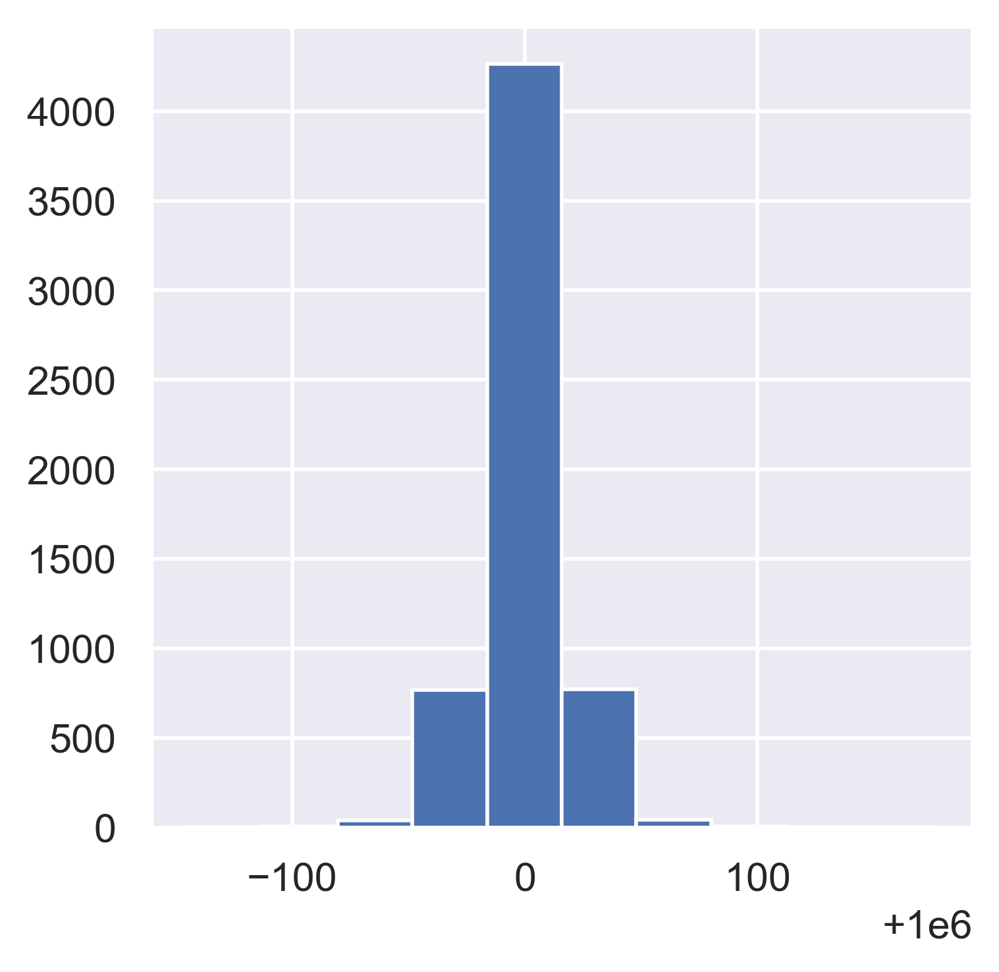

In [5]:
# plt.figure(figsize=(4, 6))
ax = plt.hist(tpm.sum(axis=1))  # dobule check TPM

In [6]:
all_dataset = an.AnnData(tpm)
all_dataset.X = csr_matrix(all_dataset.X)
all_dataset

AnnData object with n_obs × n_vars = 5902 × 23686

In [7]:
all_dataset.X

<5902x23686 sparse matrix of type '<class 'numpy.float32'>'
	with 25443148 stored elements in Compressed Sparse Row format>

In [8]:
anno = pd.read_csv(os.path.join(file_path, 'hnscc_anno.txt'), sep='\t', index_col=0, 
                   dtype={'processed by Maxima enzyme': str, 'Lymph node': str, 'classified as cancer cell': str, 
                          'classified as non-cancer cells': str, 'non-cancer cell type': str})
anno = anno.T
anno.head(2)

,processed by Maxima enzyme,Lymph node,classified as cancer cell,classified as non-cancer cells,non-cancer cell type
HN28_P15_D06_S330_comb,1,1,0,1,Fibroblast
HN28_P6_G05_S173_comb,1,0,0,1,Fibroblast


In [9]:
for col in anno.columns:
    anno[col] = anno[col].astype(str)

anno.dtypes

processed by Maxima enzyme        object
Lymph node                        object
classified  as cancer cell        object
classified as non-cancer cells    object
non-cancer cell type              object
dtype: object

In [10]:
anno['sample_id'] = [i.replace('HNSCC', 'HN').split('_')[0] for i in anno.index.to_list()]

In [11]:
np.all(all_dataset.obs.index == anno.index)

True

In [12]:
all_dataset.obs = anno

In [13]:
all_dataset

AnnData object with n_obs × n_vars = 5902 × 23686
    obs: 'processed by Maxima enzyme', 'Lymph node', 'classified  as cancer cell', 'classified as non-cancer cells', 'non-cancer cell type', 'sample_id'

In [14]:
all_files = list(all_dataset.obs['sample_id'].unique())
all_files

['HN28',
 'HN26',
 'HN25',
 'HN23',
 'HN24',
 'HN22',
 'HN18',
 'HN20',
 'HN17',
 'HN',
 'HN16',
 'HN12',
 'HN13',
 'HN10',
 'HN6',
 'HN5',
 'HN7',
 'HN8']

... storing 'processed by Maxima enzyme' as categorical
... storing 'Lymph node' as categorical
... storing 'classified  as cancer cell' as categorical
... storing 'classified as non-cancer cells' as categorical
... storing 'non-cancer cell type' as categorical
... storing 'sample_id' as categorical


#----------------------------------------------
Deal with HN28...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (616, 23686)


<Figure size 3000x600 with 0 Axes>

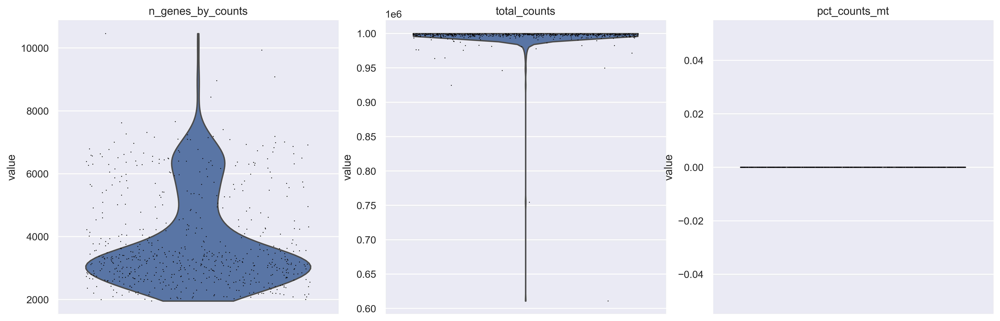

<Figure size 1600x1200 with 0 Axes>

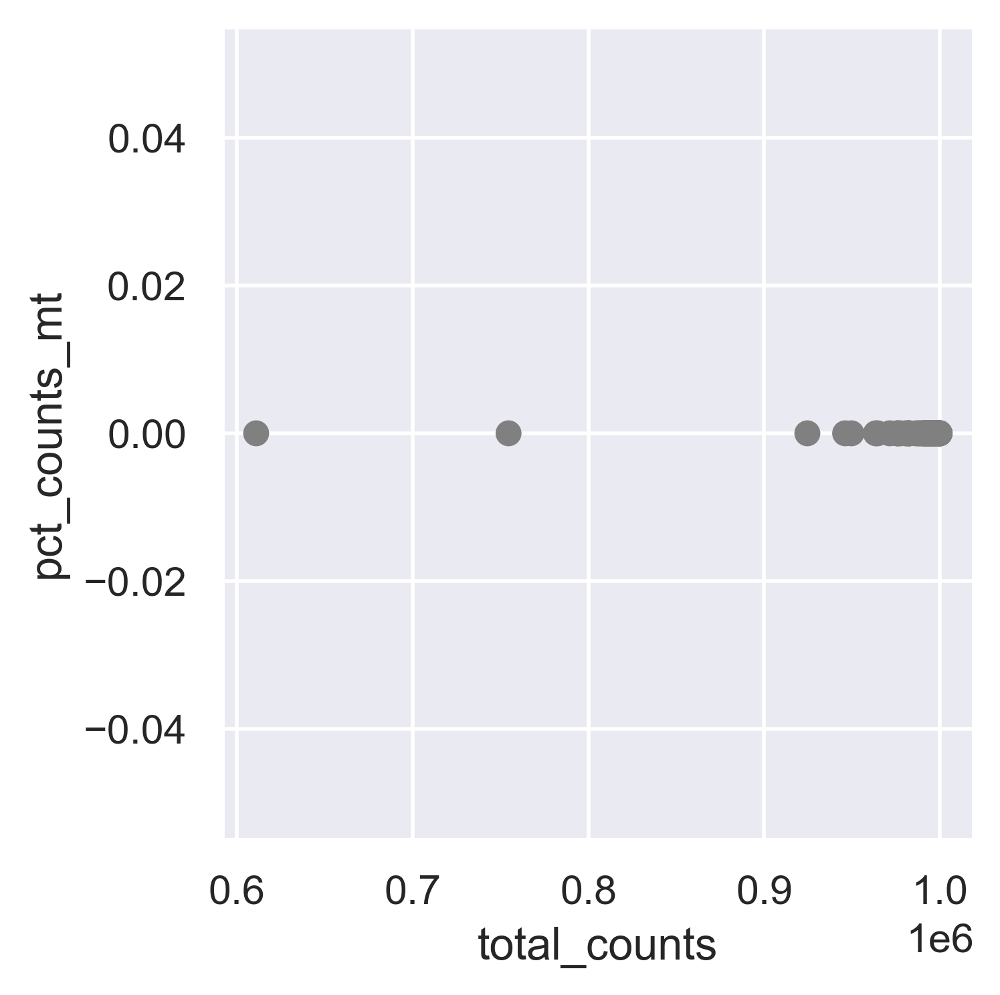

<Figure size 1600x1200 with 0 Axes>

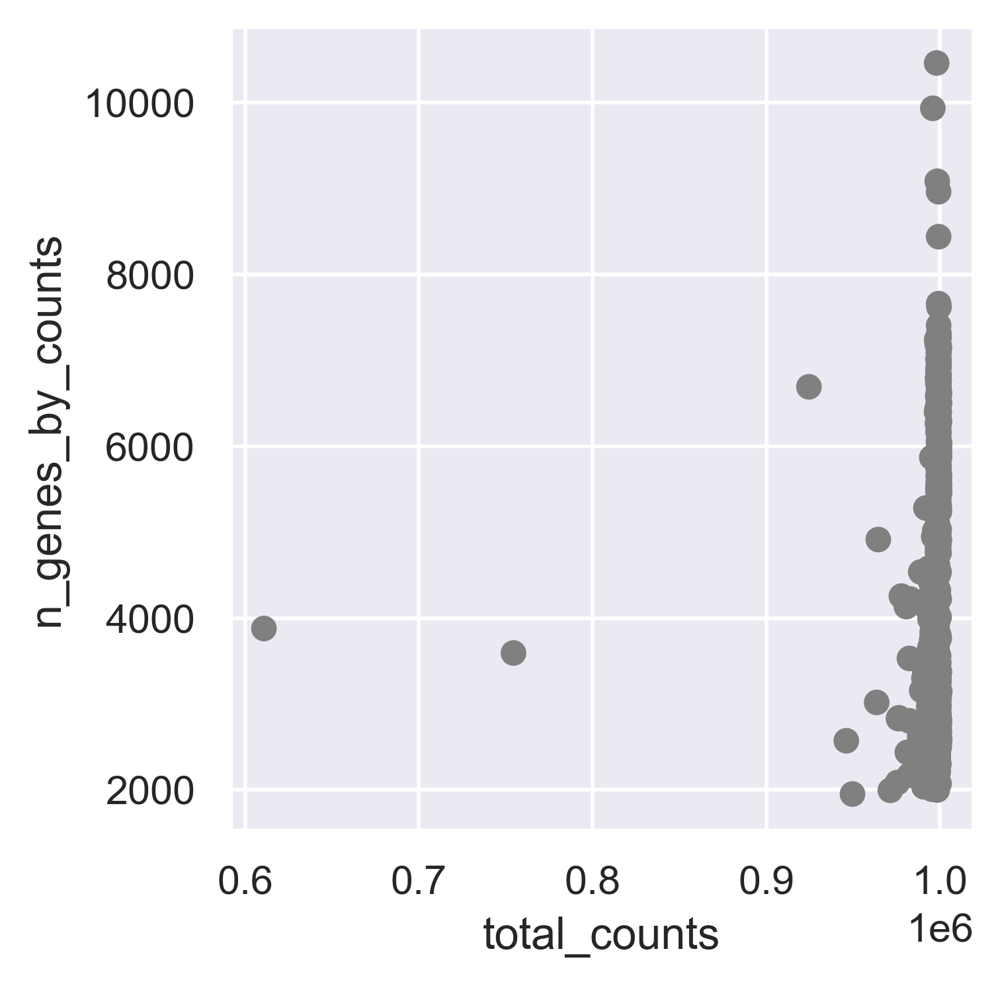

f:\tools\miniconda3\envs\deside3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... storing 'processed by Maxima enzyme' as categorical
... storing 'Lymph node' as categorical
... storing 'classified  as cancer cell' as categorical


   The shape of adata after filtering is: (611, 15429)
#----------------------------------------------
Deal with HN26...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (428, 23686)


... storing 'classified as non-cancer cells' as categorical
... storing 'non-cancer cell type' as categorical
... storing 'sample_id' as categorical


<Figure size 3000x600 with 0 Axes>

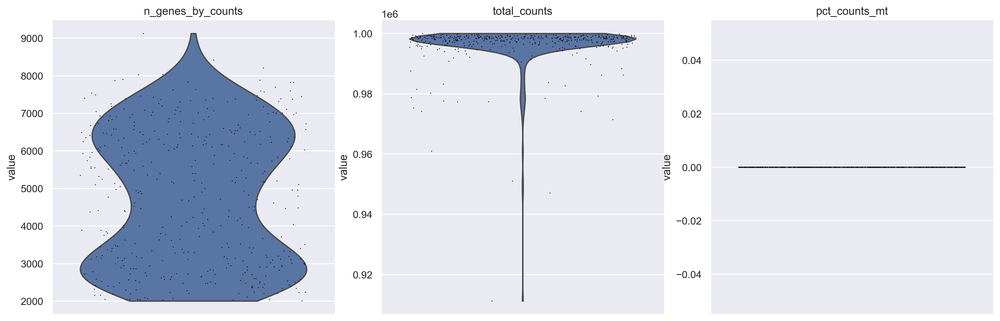

<Figure size 1600x1200 with 0 Axes>

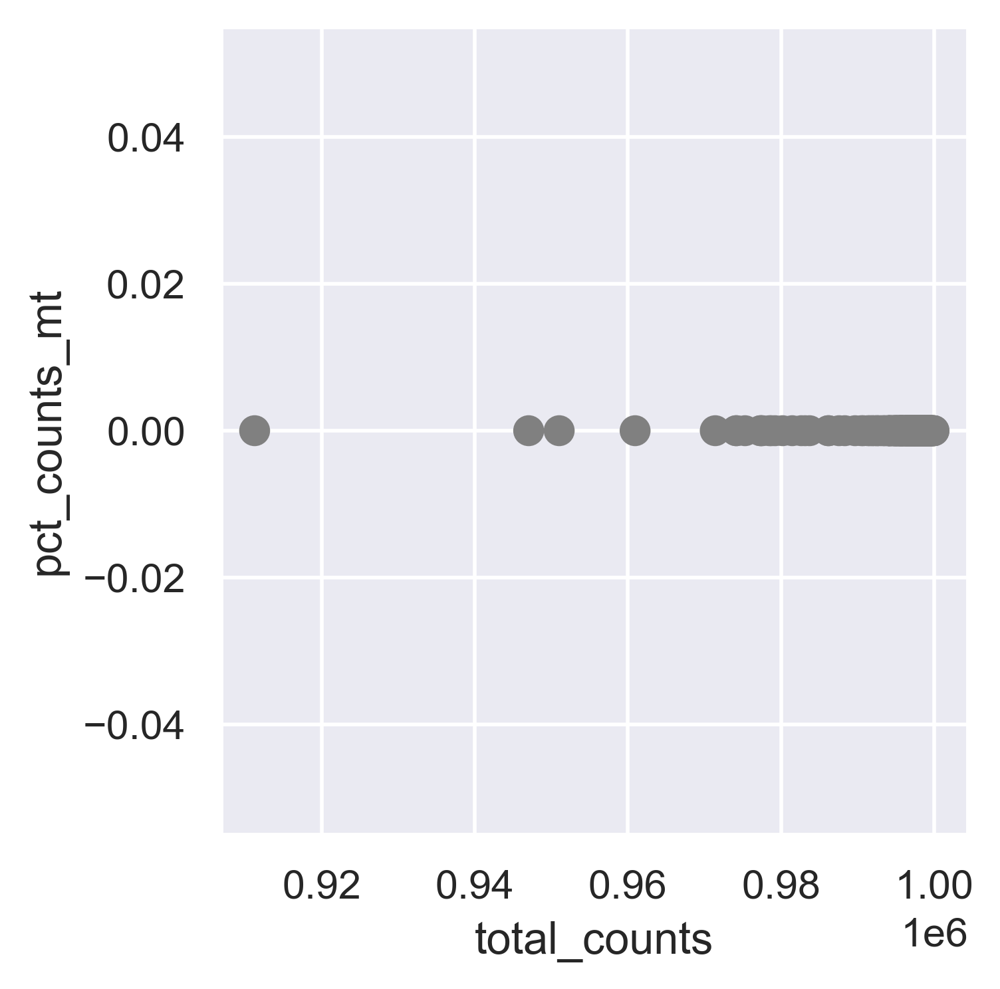

<Figure size 1600x1200 with 0 Axes>

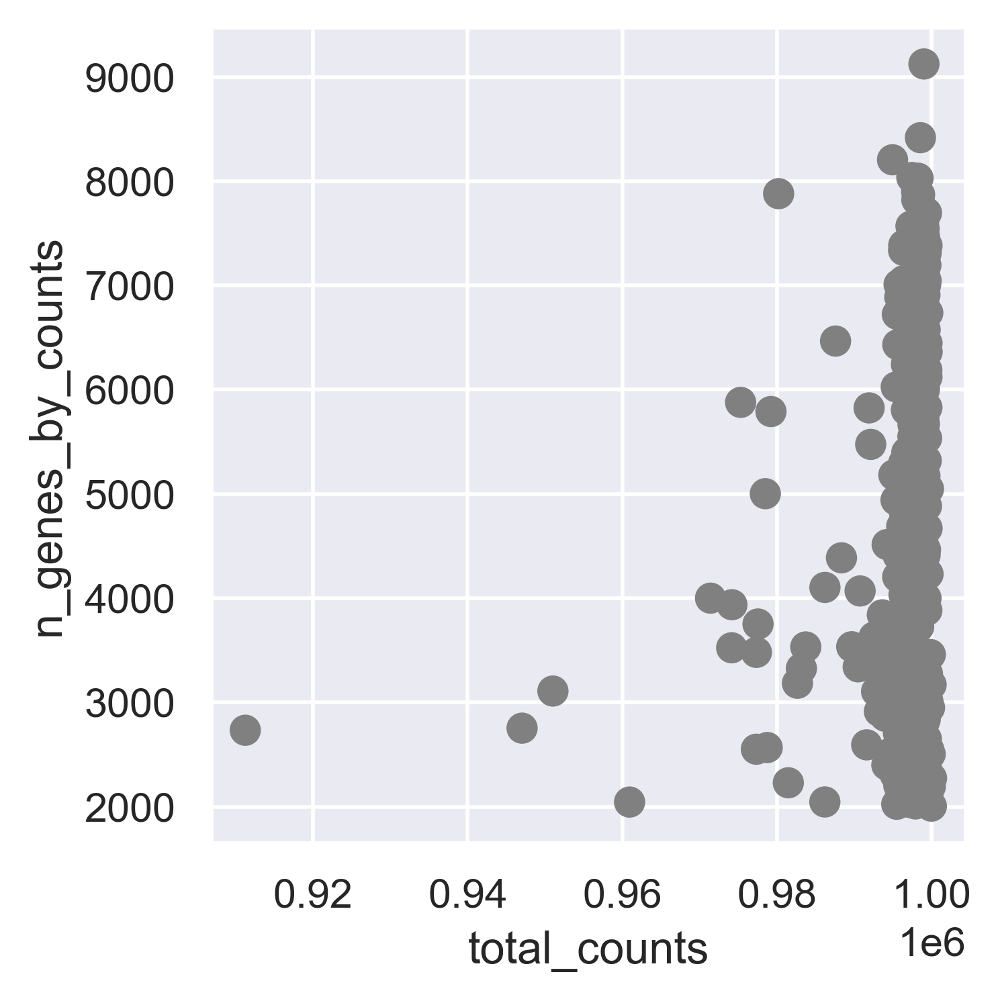

f:\tools\miniconda3\envs\deside3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... storing 'processed by Maxima enzyme' as categorical


   The shape of adata after filtering is: (423, 15857)
#----------------------------------------------
Deal with HN25...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (725, 23686)


... storing 'Lymph node' as categorical
... storing 'classified  as cancer cell' as categorical
... storing 'classified as non-cancer cells' as categorical
... storing 'non-cancer cell type' as categorical
... storing 'sample_id' as categorical


<Figure size 3000x600 with 0 Axes>

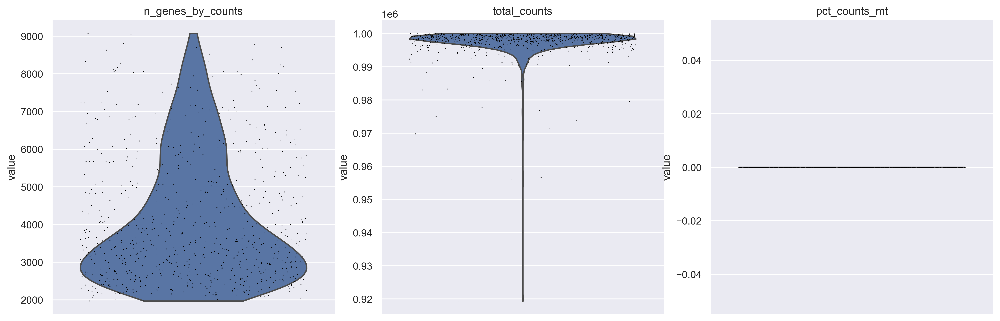

<Figure size 1600x1200 with 0 Axes>

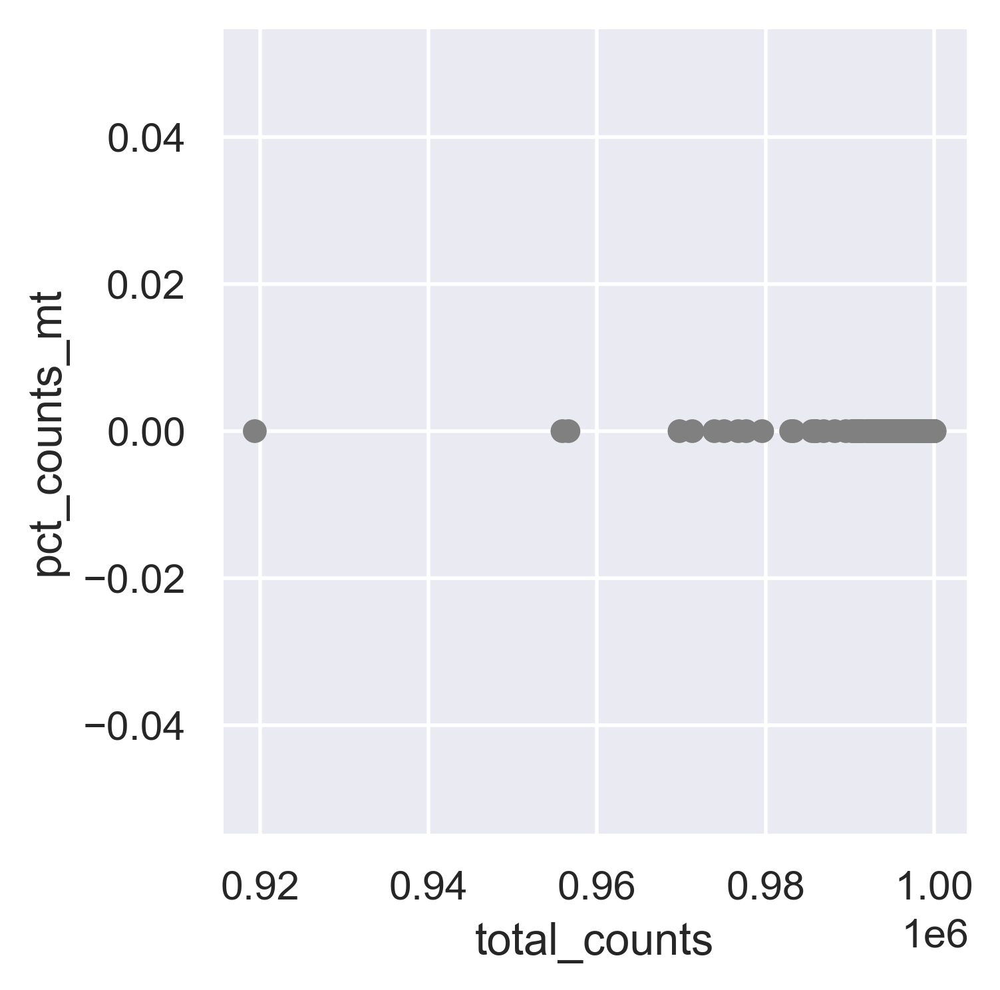

<Figure size 1600x1200 with 0 Axes>

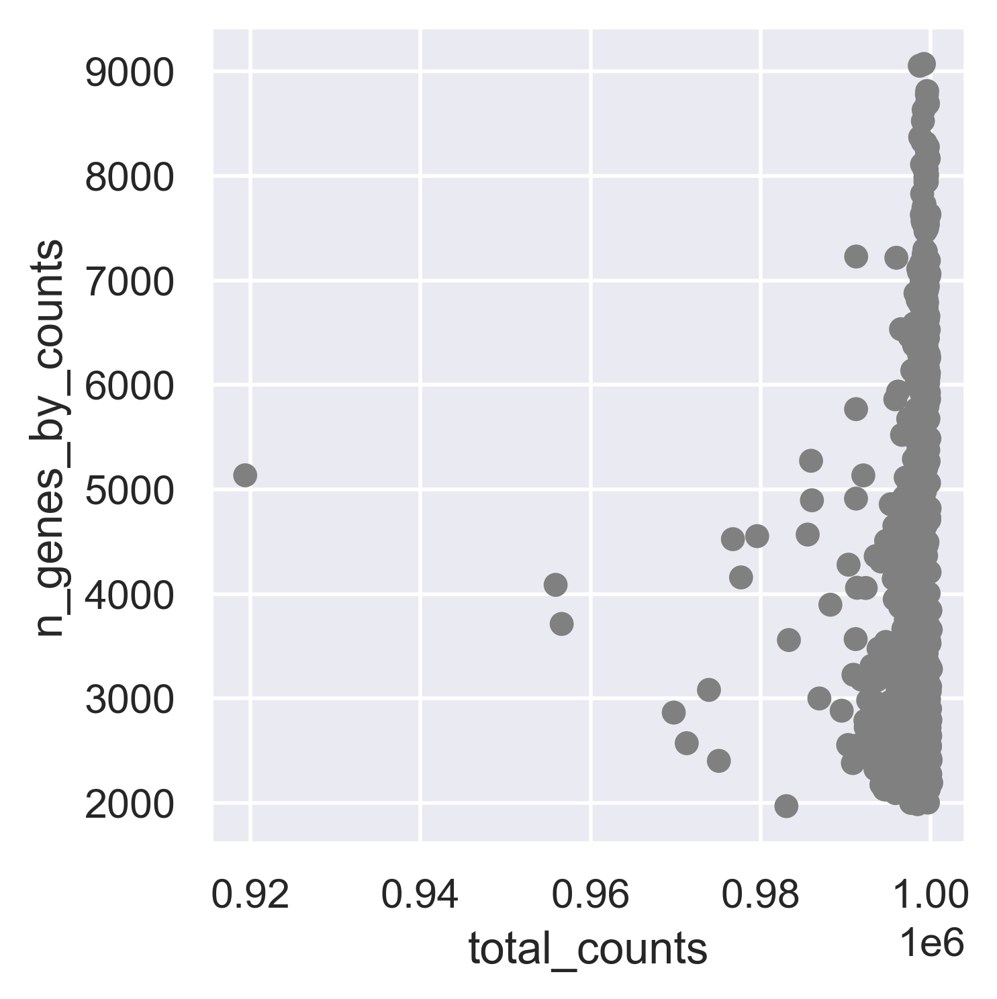

f:\tools\miniconda3\envs\deside3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... storing 'processed by Maxima enzyme' as categorical
... storing 'Lymph node' as categorical
... storing 'classified  as cancer cell' as categorical
... storing 'classified as non-cancer cells' as categorical
... storing 'non-cancer cell type' as categorical
... storing 'sample_id' as categorical


   The shape of adata after filtering is: (702, 15748)
#----------------------------------------------
Deal with HN24...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (130, 23686)


<Figure size 3000x600 with 0 Axes>

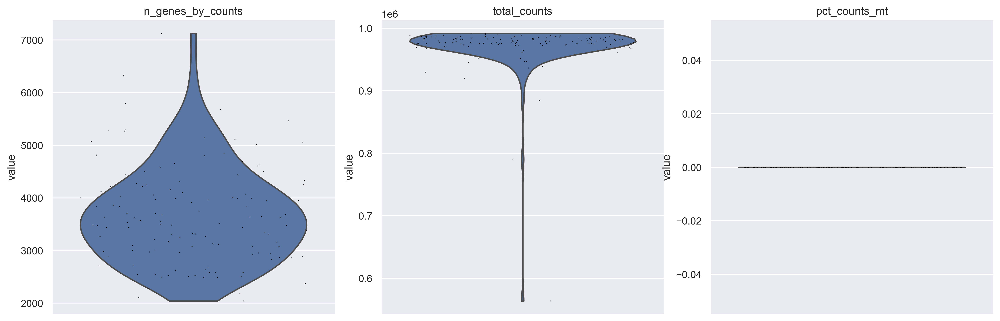

<Figure size 1600x1200 with 0 Axes>

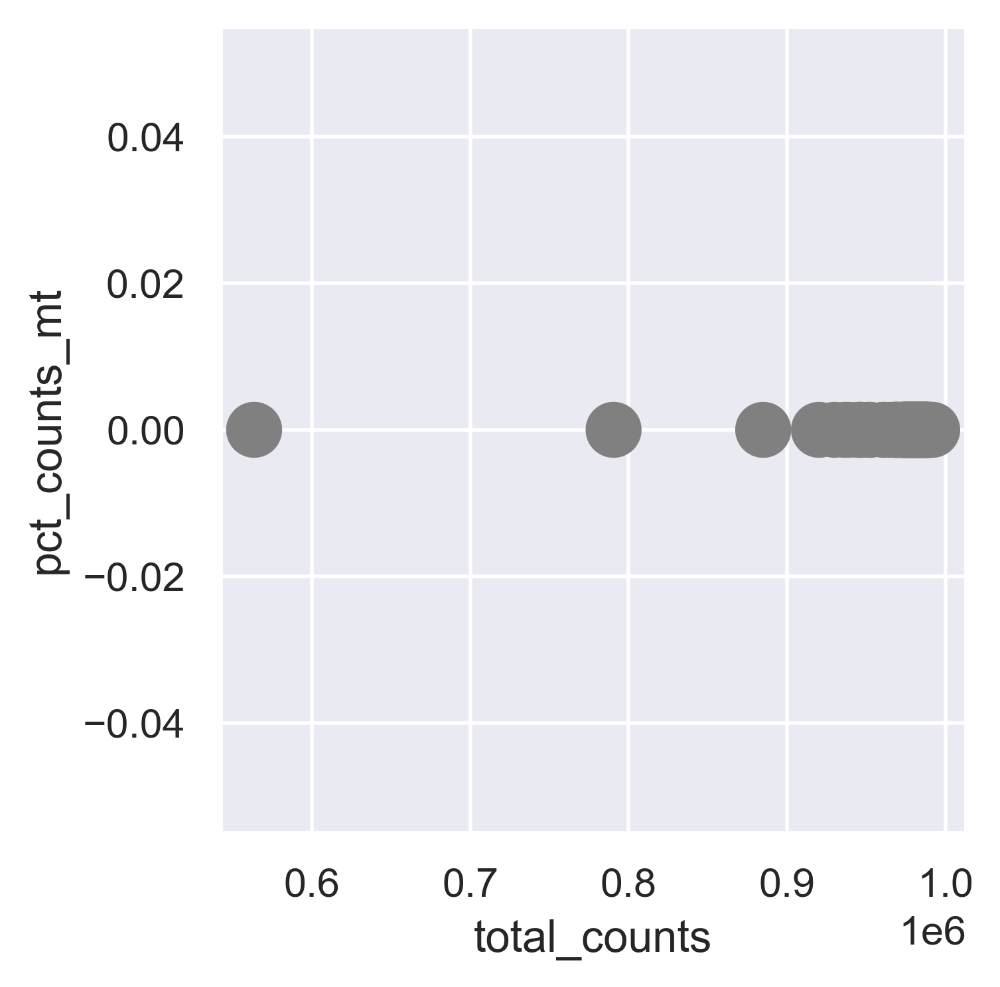

<Figure size 1600x1200 with 0 Axes>

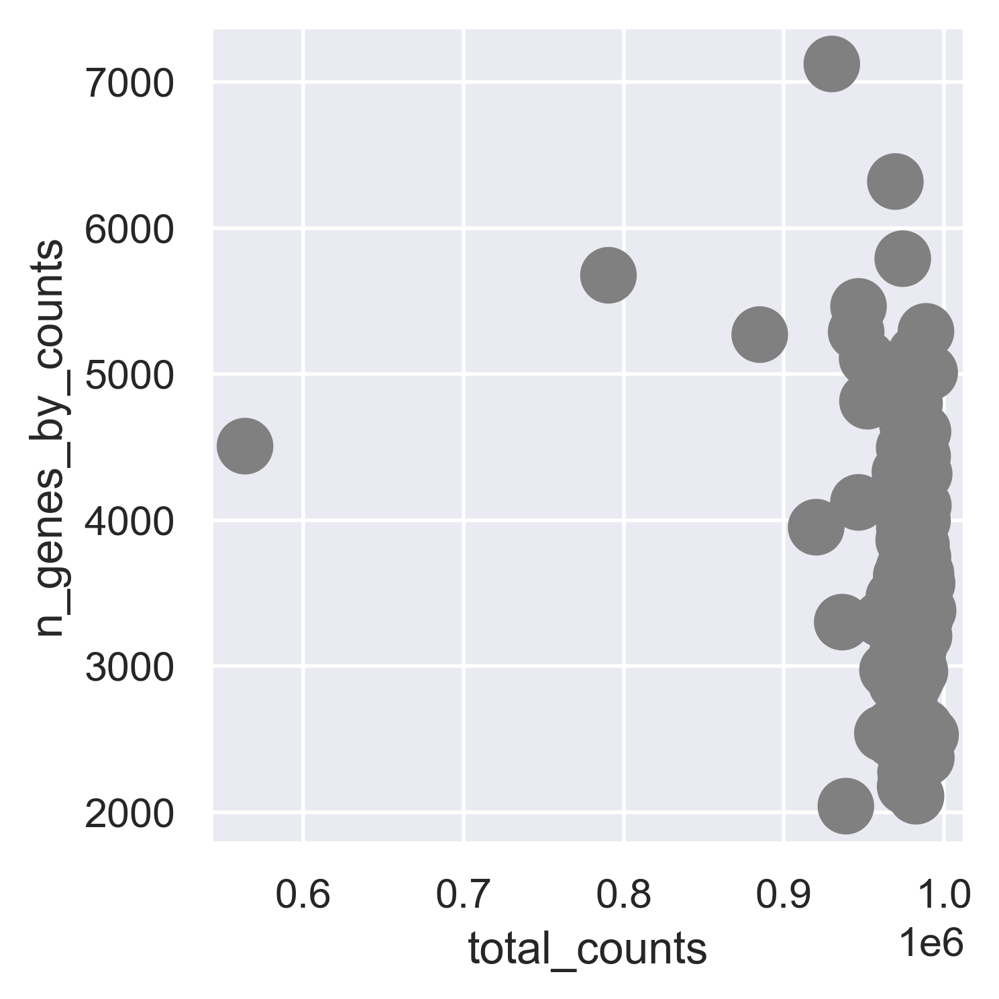

f:\tools\miniconda3\envs\deside3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... storing 'processed by Maxima enzyme' as categorical
... storing 'Lymph node' as categorical
... storing 'classified  as cancer cell' as categorical
... storing 'classified as non-cancer cells' as categorical
... storing 'non-cancer cell type' as categorical
... storing 'sample_id' as categorical


   The shape of adata after filtering is: (130, 10779)
#----------------------------------------------
Deal with HN22...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (201, 23686)


<Figure size 3000x600 with 0 Axes>

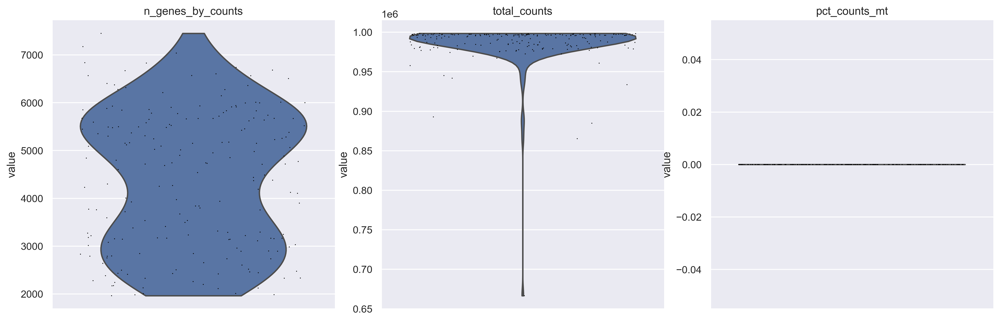

<Figure size 1600x1200 with 0 Axes>

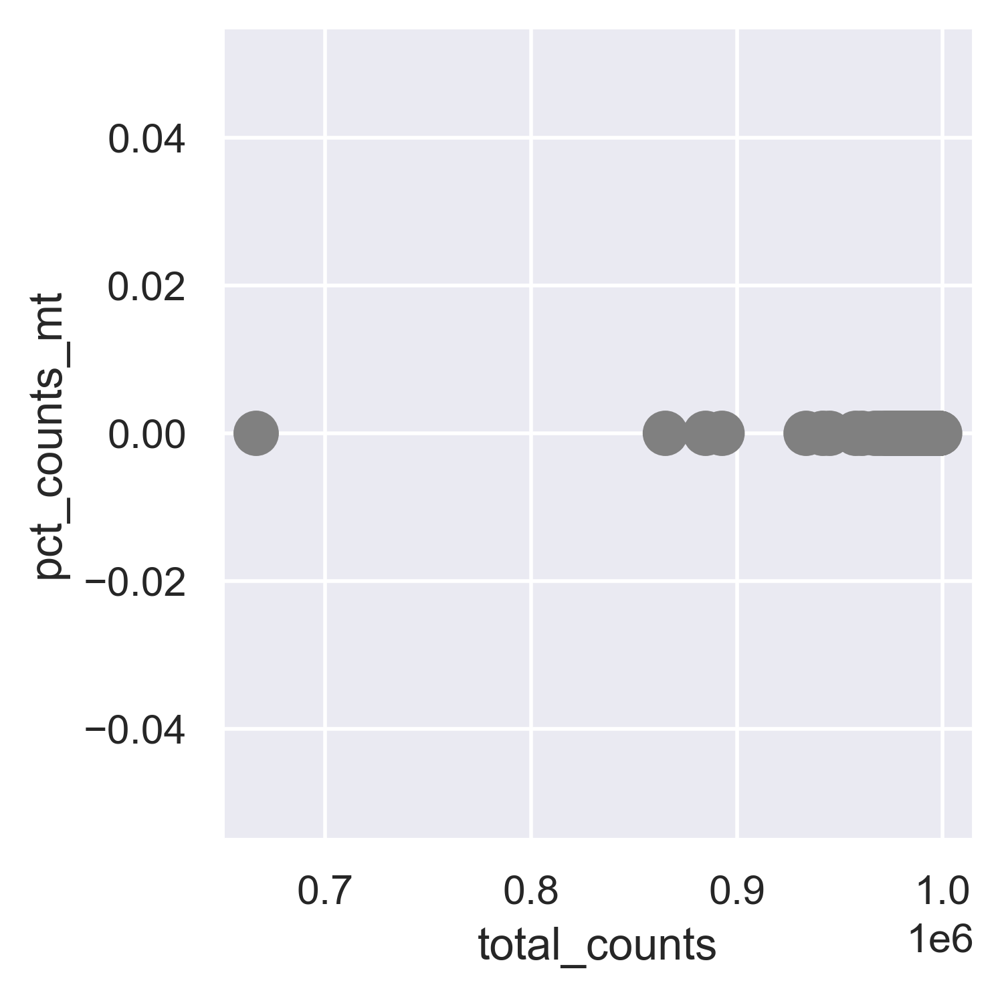

<Figure size 1600x1200 with 0 Axes>

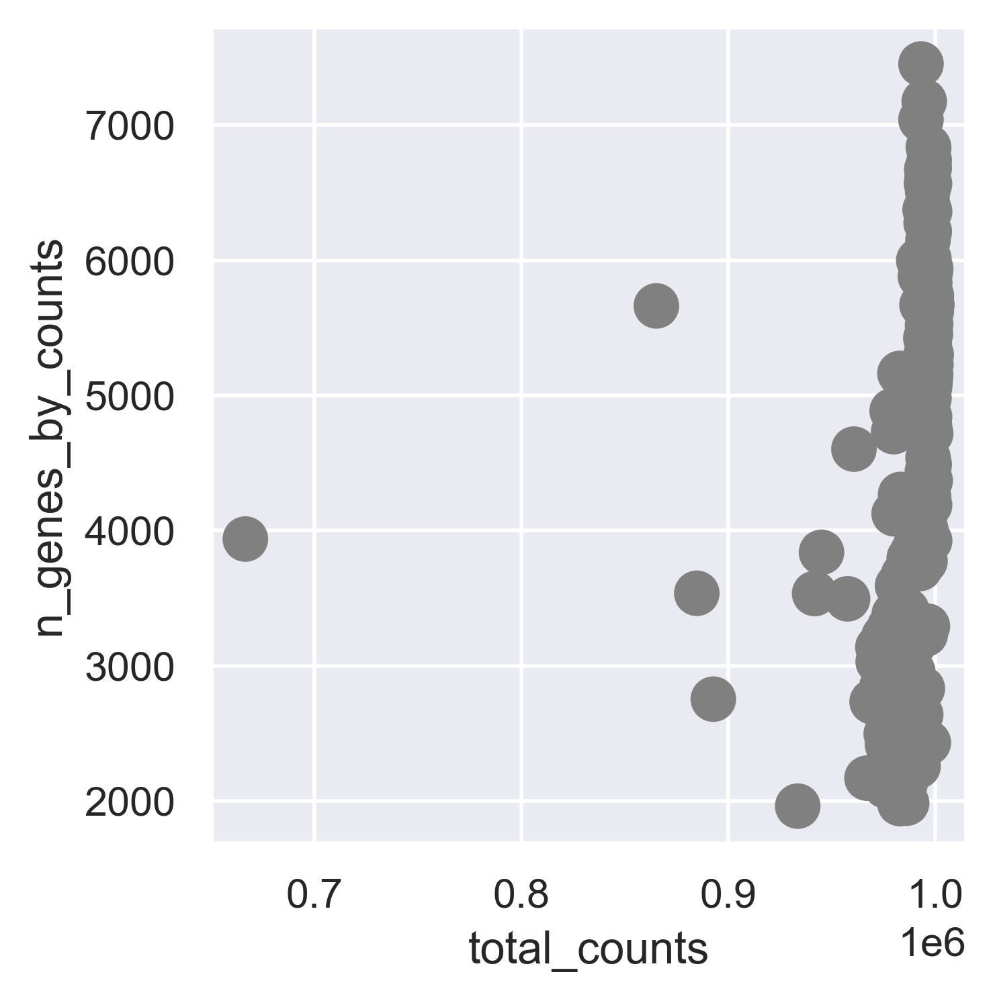

f:\tools\miniconda3\envs\deside3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... storing 'processed by Maxima enzyme' as categorical
... storing 'Lymph node' as categorical
... storing 'classified  as cancer cell' as categorical
... storing 'classified as non-cancer cells' as categorical
... storing 'non-cancer cell type' as categorical
... storing 'sample_id' as categorical


   The shape of adata after filtering is: (201, 12780)
#----------------------------------------------
Deal with HN18...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (567, 23686)


<Figure size 3000x600 with 0 Axes>

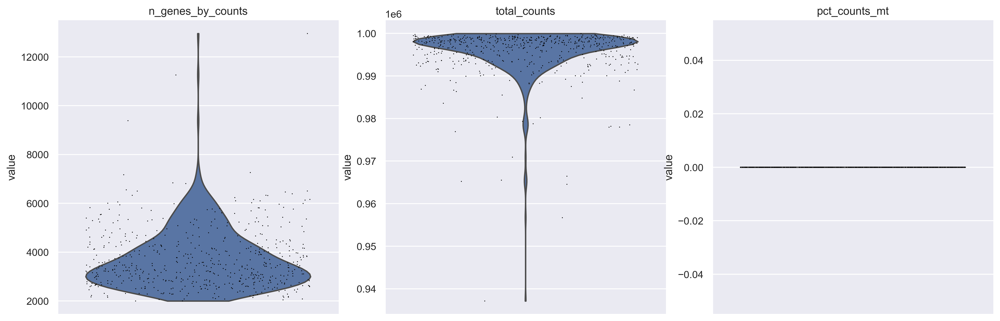

<Figure size 1600x1200 with 0 Axes>

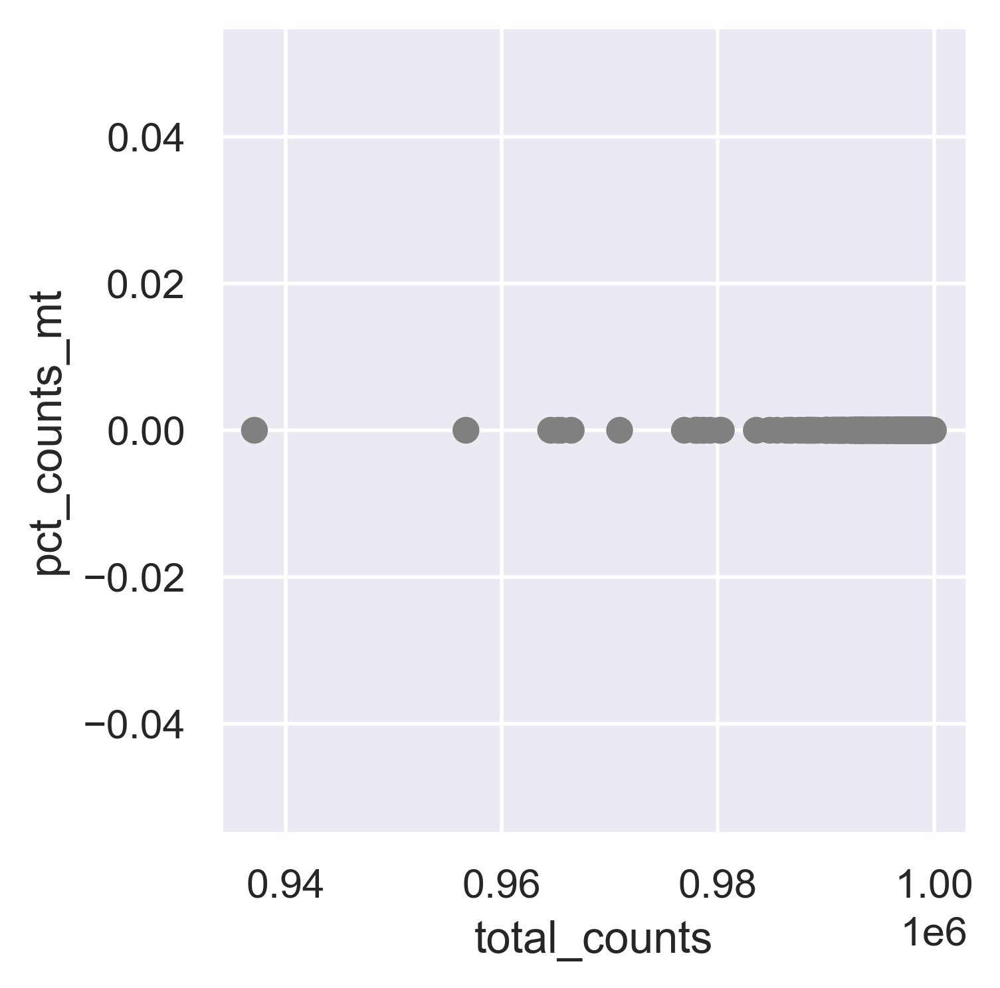

<Figure size 1600x1200 with 0 Axes>

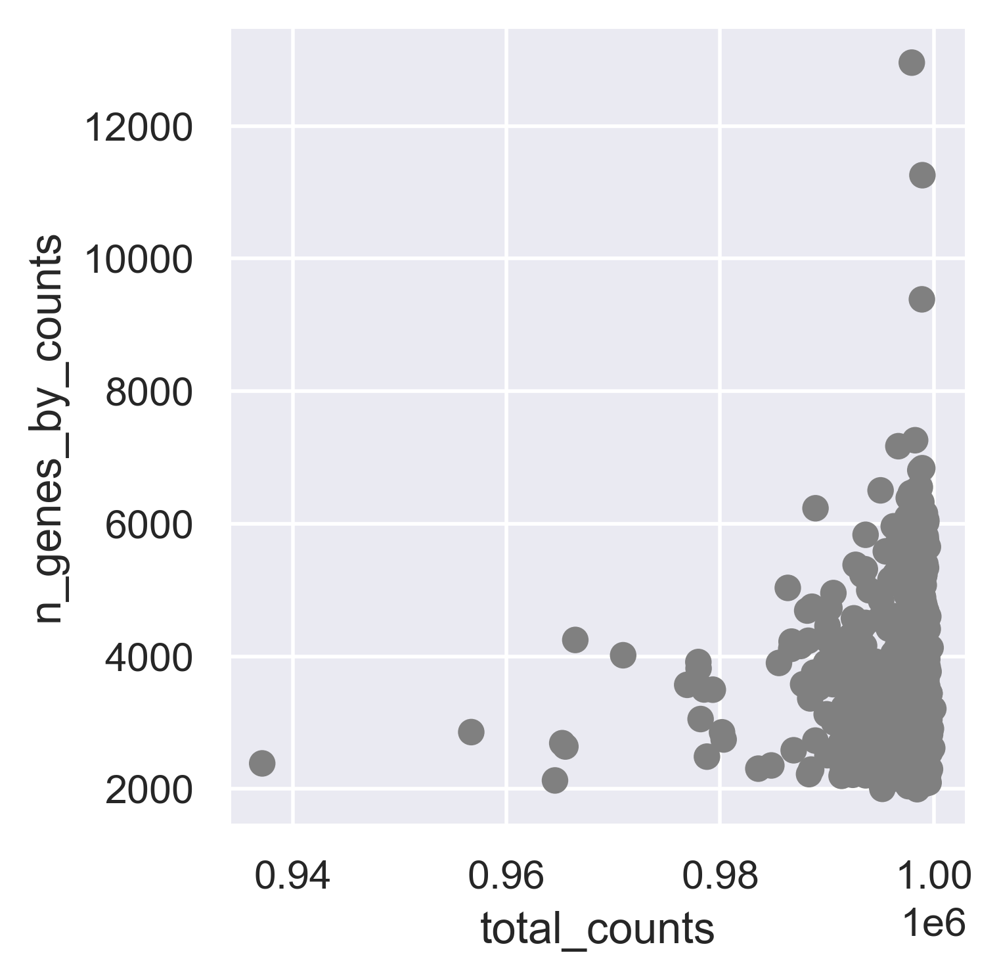

f:\tools\miniconda3\envs\deside3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (564, 15065)
#----------------------------------------------
Deal with HN20...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (691, 23686)


... storing 'processed by Maxima enzyme' as categorical
... storing 'Lymph node' as categorical
... storing 'classified  as cancer cell' as categorical
... storing 'classified as non-cancer cells' as categorical
... storing 'non-cancer cell type' as categorical
... storing 'sample_id' as categorical


<Figure size 3000x600 with 0 Axes>

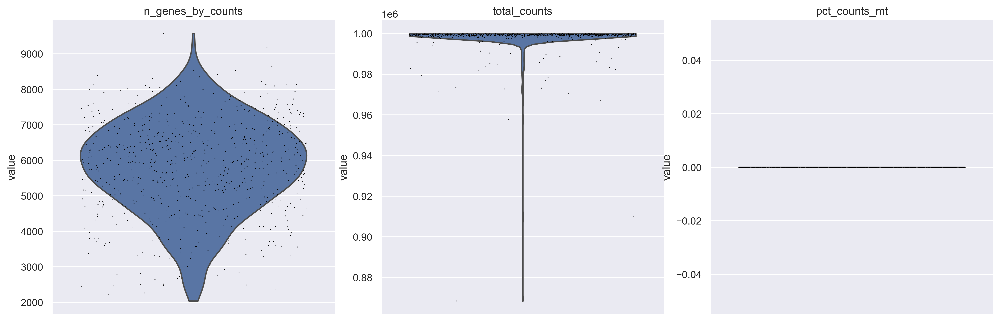

<Figure size 1600x1200 with 0 Axes>

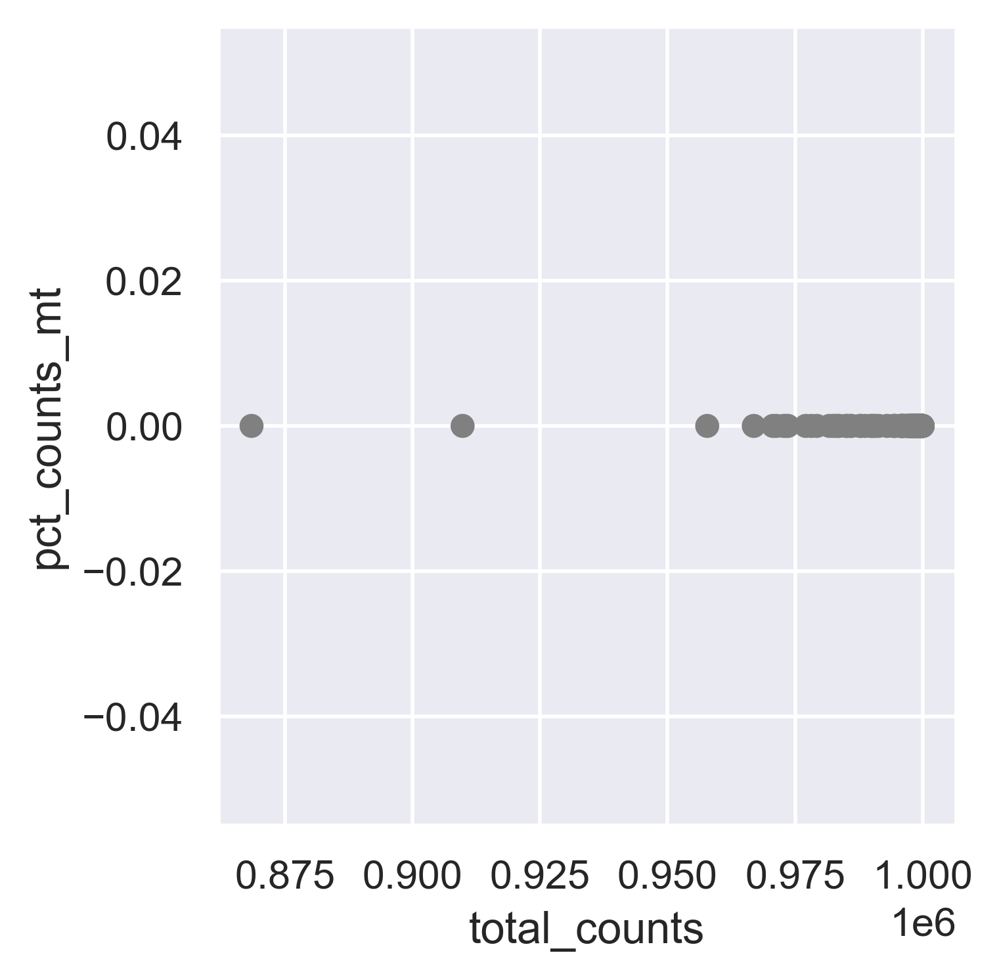

<Figure size 1600x1200 with 0 Axes>

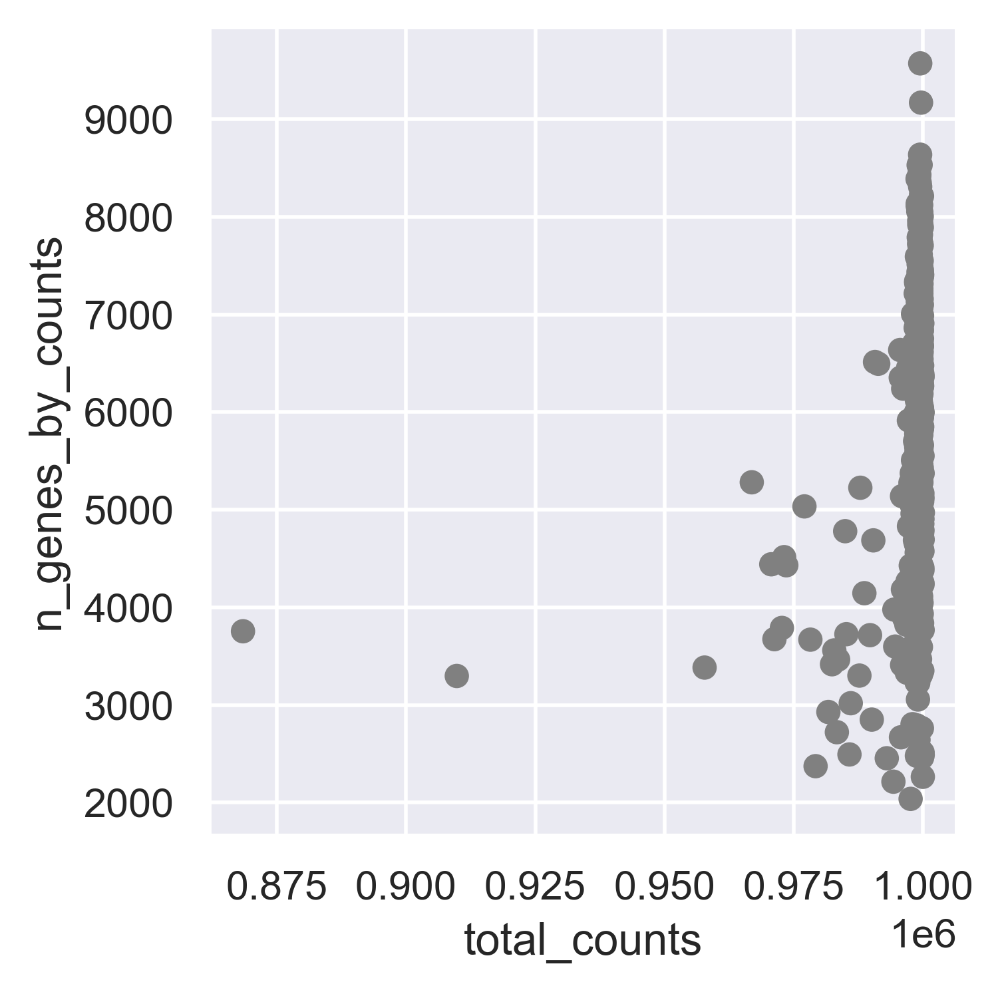

f:\tools\miniconda3\envs\deside3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... storing 'processed by Maxima enzyme' as categorical
... storing 'Lymph node' as categorical
... storing 'classified  as cancer cell' as categorical
... storing 'classified as non-cancer cells' as categorical
... storing 'non-cancer cell type' as categorical
... storing 'sample_id' as categorical


   The shape of adata after filtering is: (668, 15862)
#----------------------------------------------
Deal with HN17...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (490, 23686)


<Figure size 3000x600 with 0 Axes>

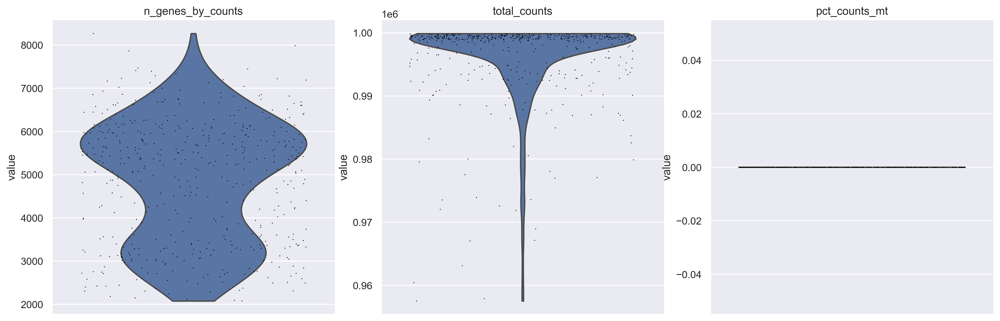

<Figure size 1600x1200 with 0 Axes>

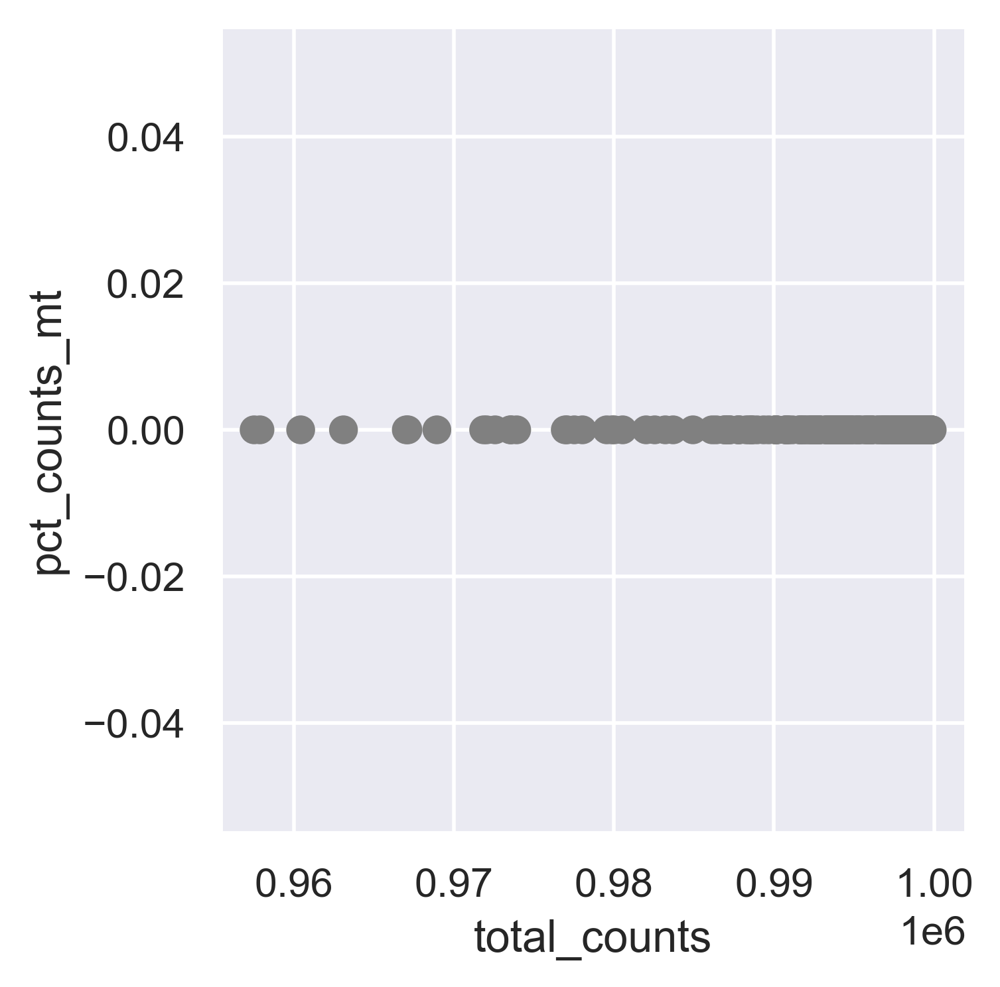

<Figure size 1600x1200 with 0 Axes>

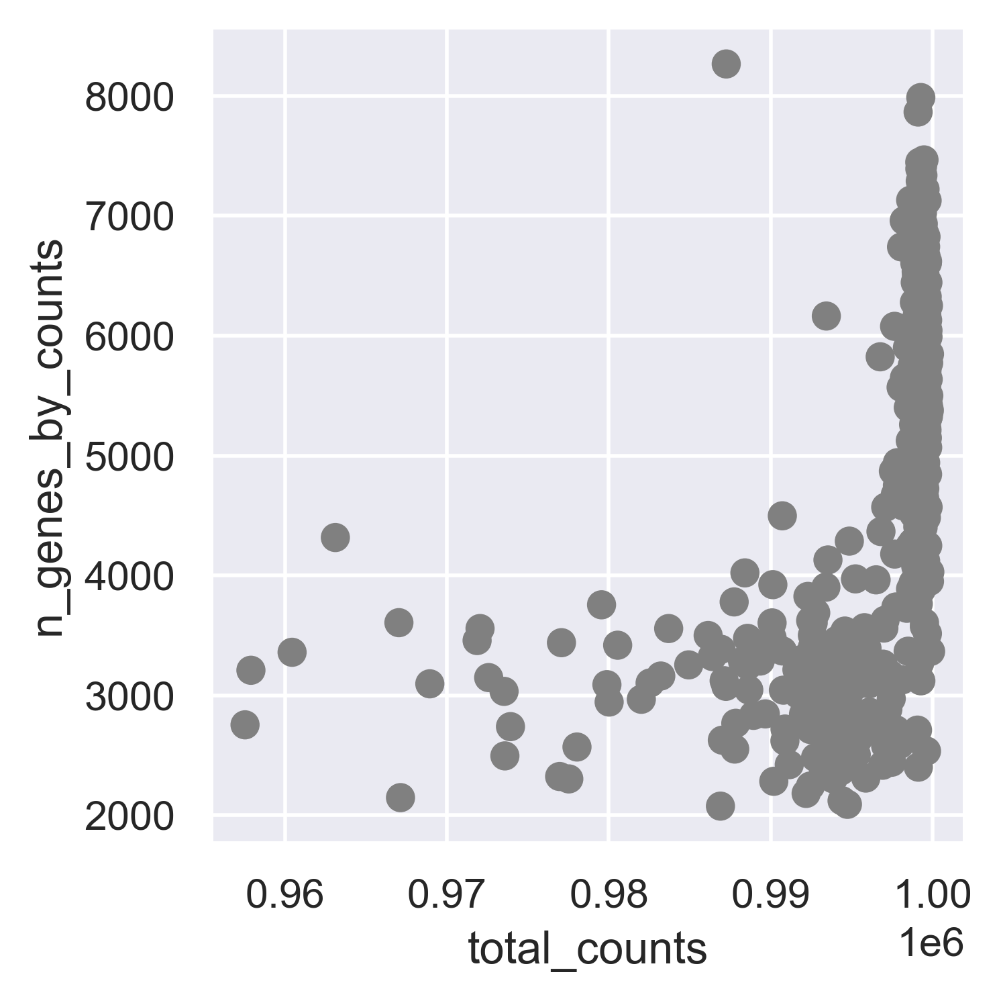

f:\tools\miniconda3\envs\deside3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... storing 'processed by Maxima enzyme' as categorical
... storing 'Lymph node' as categorical
... storing 'classified  as cancer cell' as categorical
... storing 'classified as non-cancer cells' as categorical
... storing 'non-cancer cell type' as categorical
... storing 'sample_id' as categorical


   The shape of adata after filtering is: (489, 14399)
#----------------------------------------------
Deal with HN...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (282, 23686)


<Figure size 3000x600 with 0 Axes>

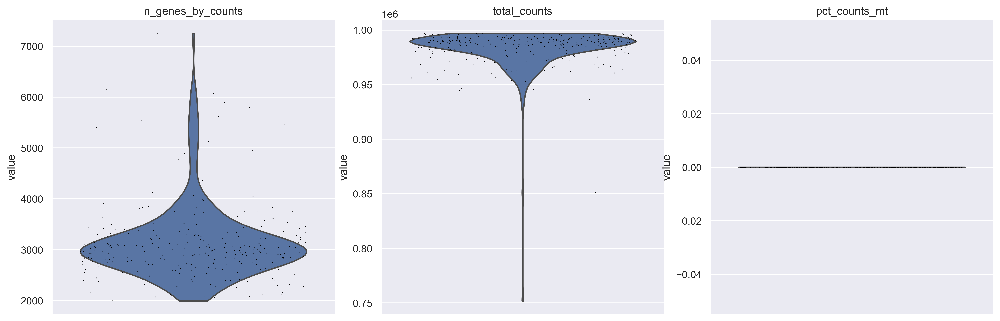

<Figure size 1600x1200 with 0 Axes>

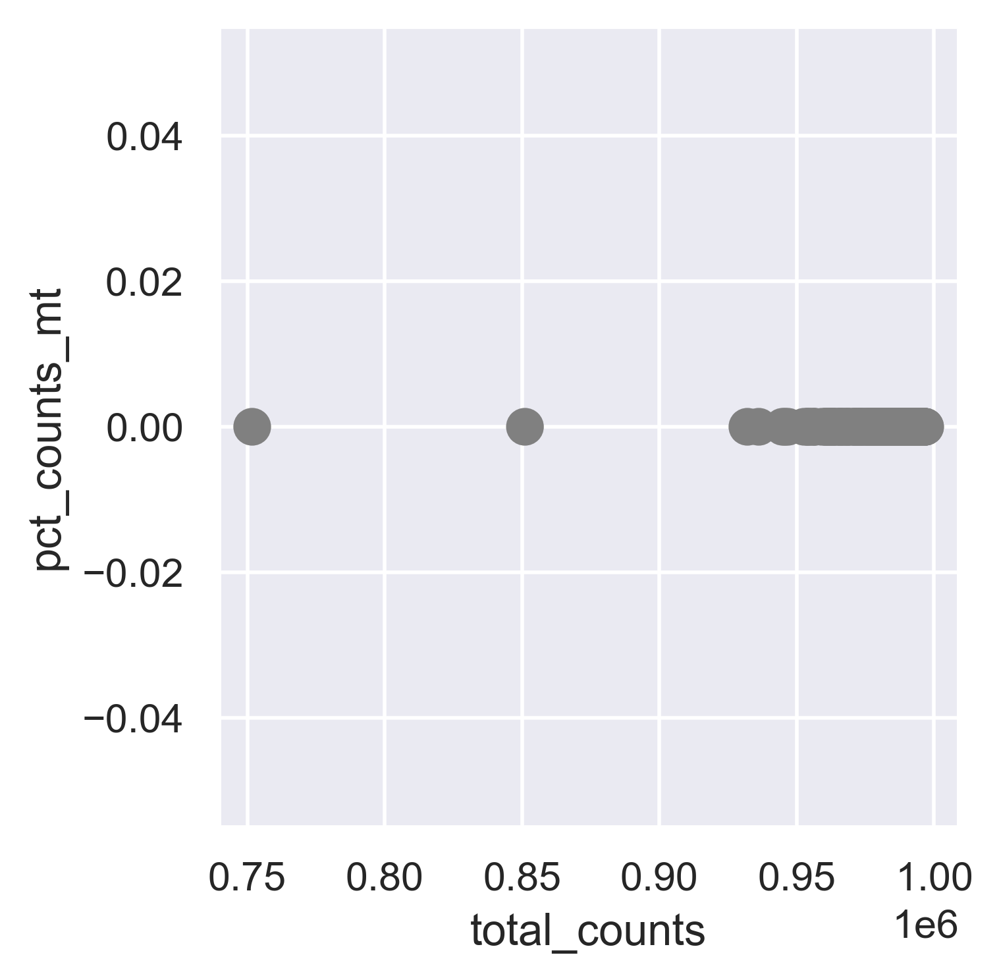

<Figure size 1600x1200 with 0 Axes>

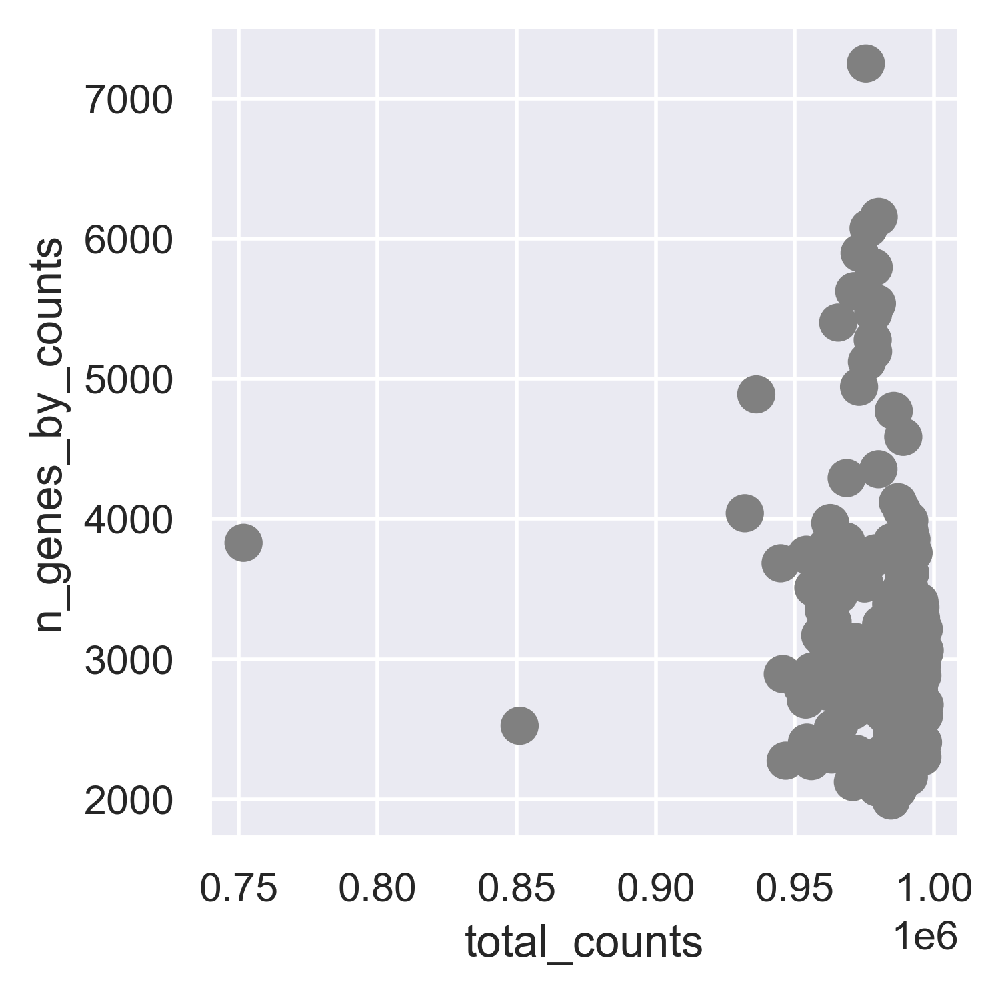

f:\tools\miniconda3\envs\deside3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... storing 'processed by Maxima enzyme' as categorical
... storing 'Lymph node' as categorical
... storing 'classified  as cancer cell' as categorical
... storing 'classified as non-cancer cells' as categorical
... storing 'non-cancer cell type' as categorical
... storing 'sample_id' as categorical


   The shape of adata after filtering is: (282, 11617)
#----------------------------------------------
Deal with HN16...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (596, 23686)


<Figure size 3000x600 with 0 Axes>

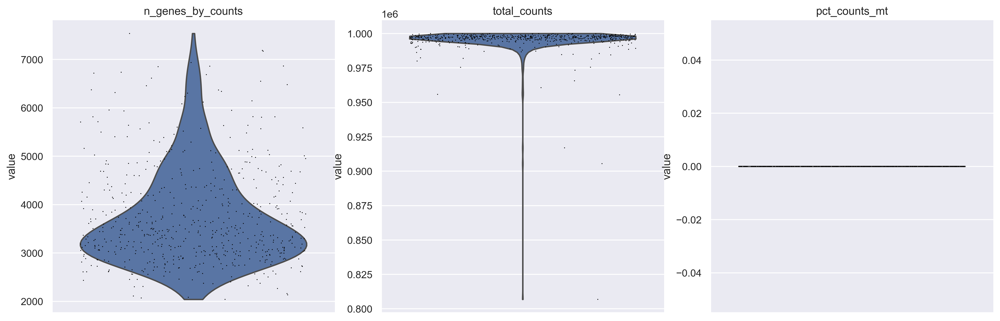

<Figure size 1600x1200 with 0 Axes>

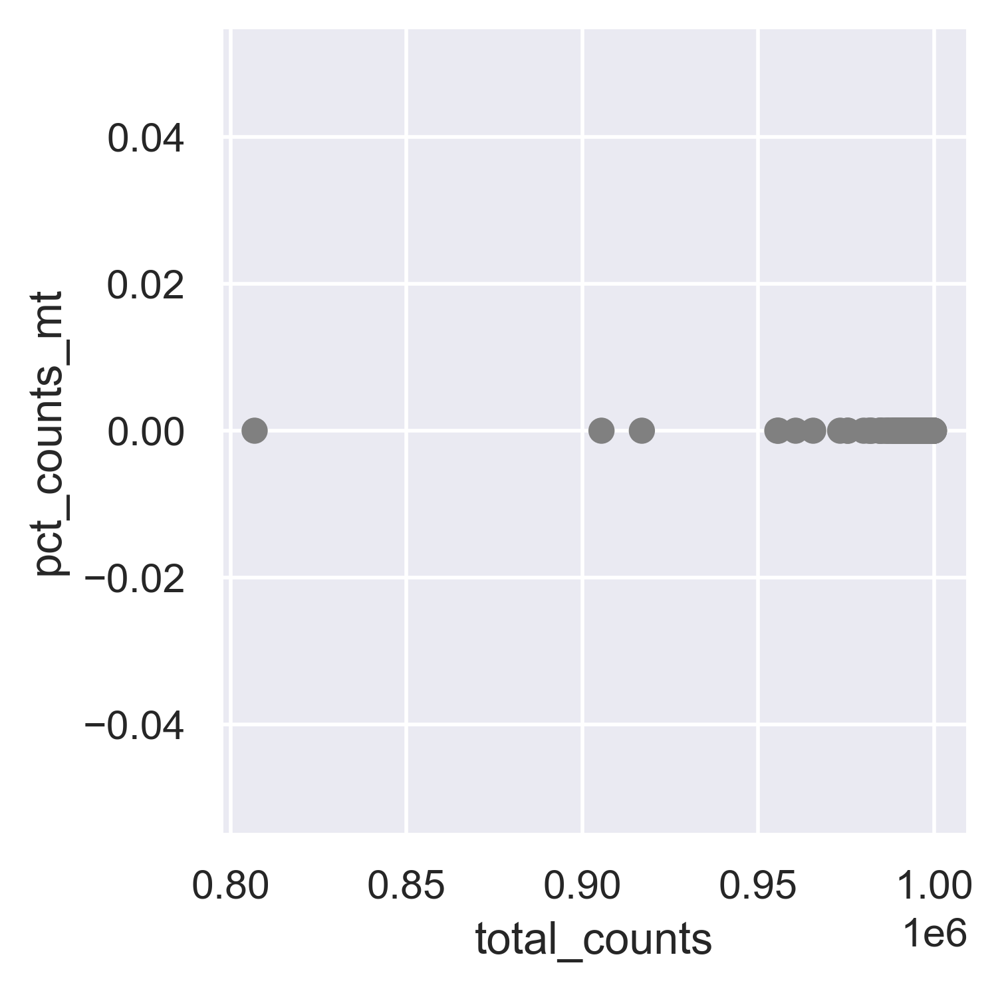

<Figure size 1600x1200 with 0 Axes>

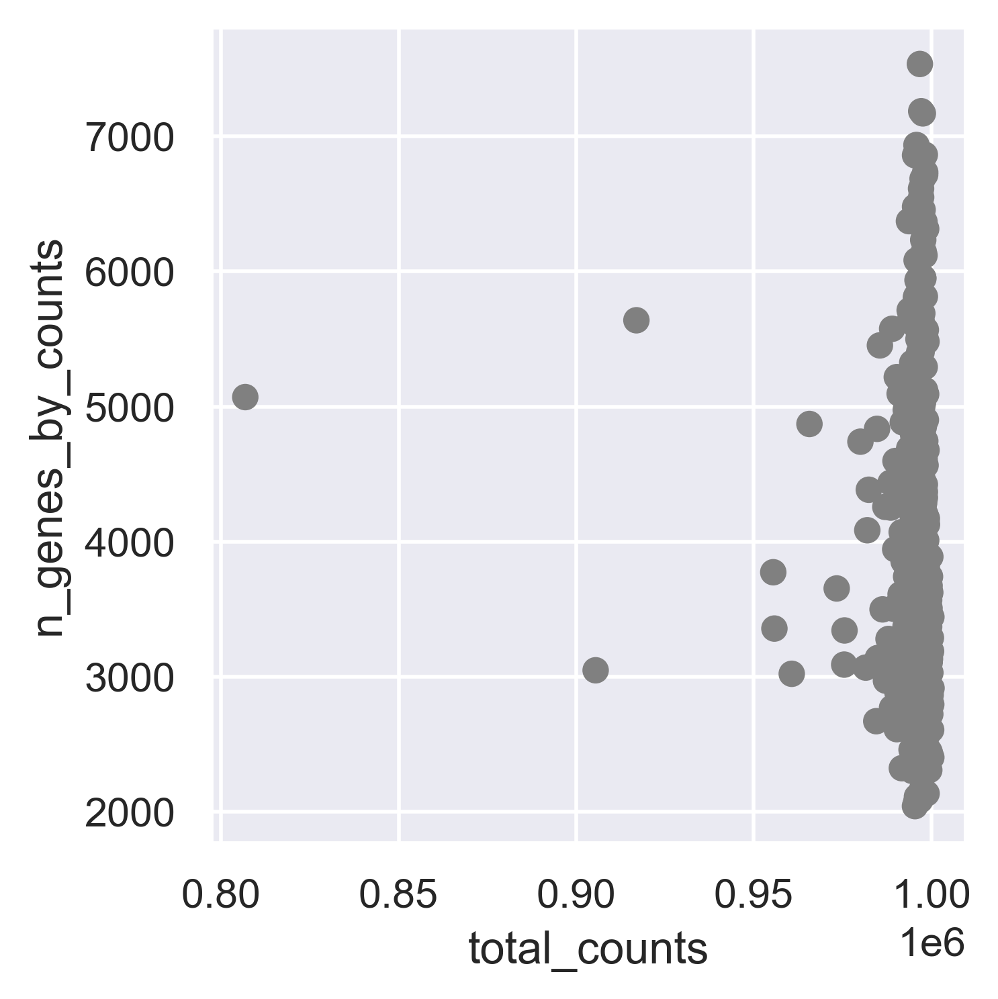

f:\tools\miniconda3\envs\deside3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... storing 'processed by Maxima enzyme' as categorical
... storing 'Lymph node' as categorical
... storing 'classified  as cancer cell' as categorical
... storing 'classified as non-cancer cells' as categorical
... storing 'non-cancer cell type' as categorical
... storing 'sample_id' as categorical


   The shape of adata after filtering is: (596, 14700)
#----------------------------------------------
Deal with HN12...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (157, 23686)


<Figure size 3000x600 with 0 Axes>

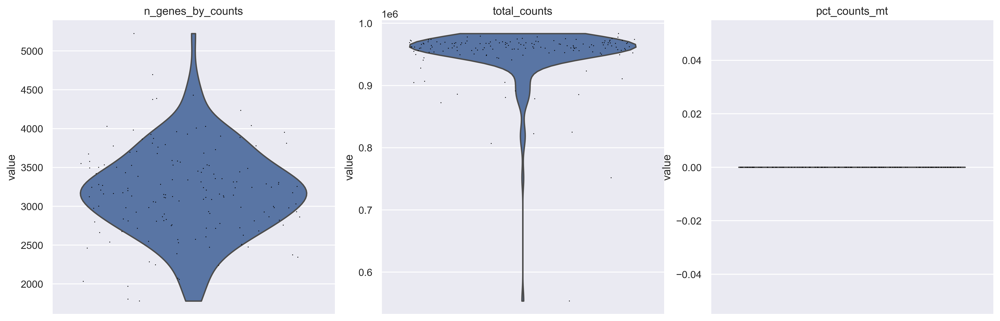

<Figure size 1600x1200 with 0 Axes>

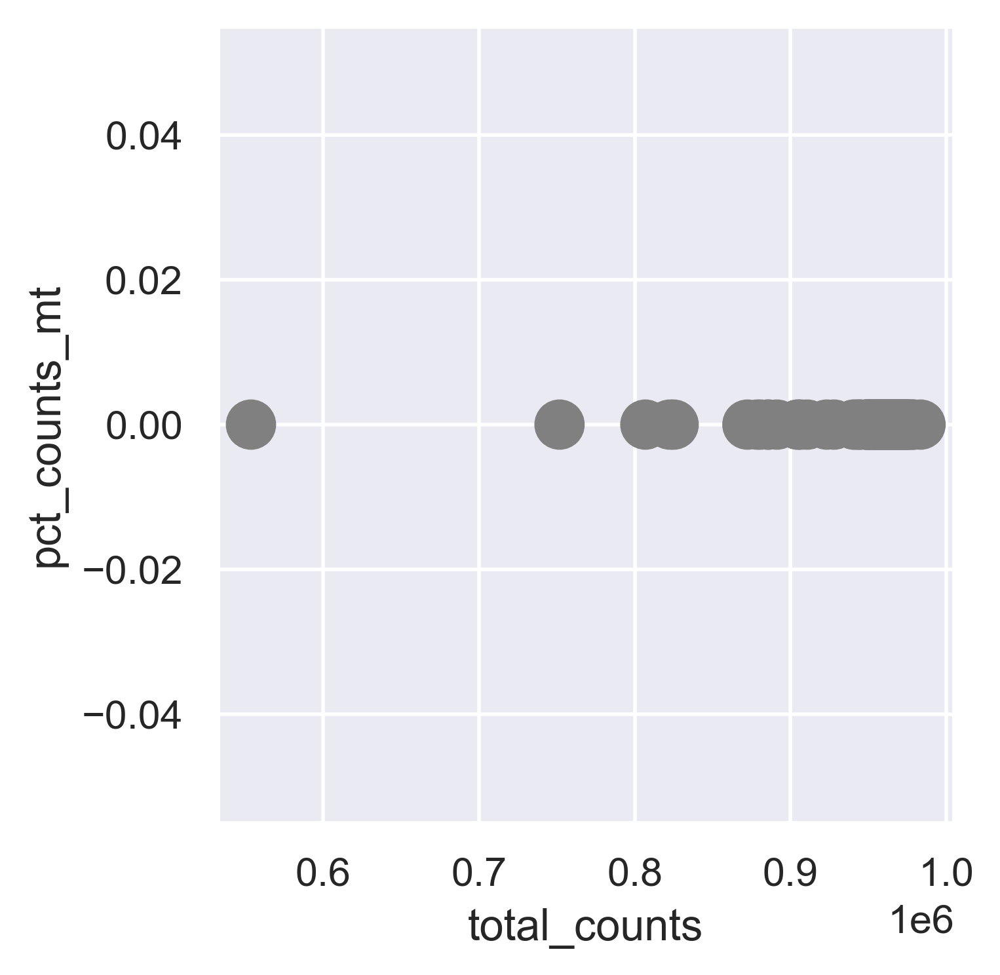

<Figure size 1600x1200 with 0 Axes>

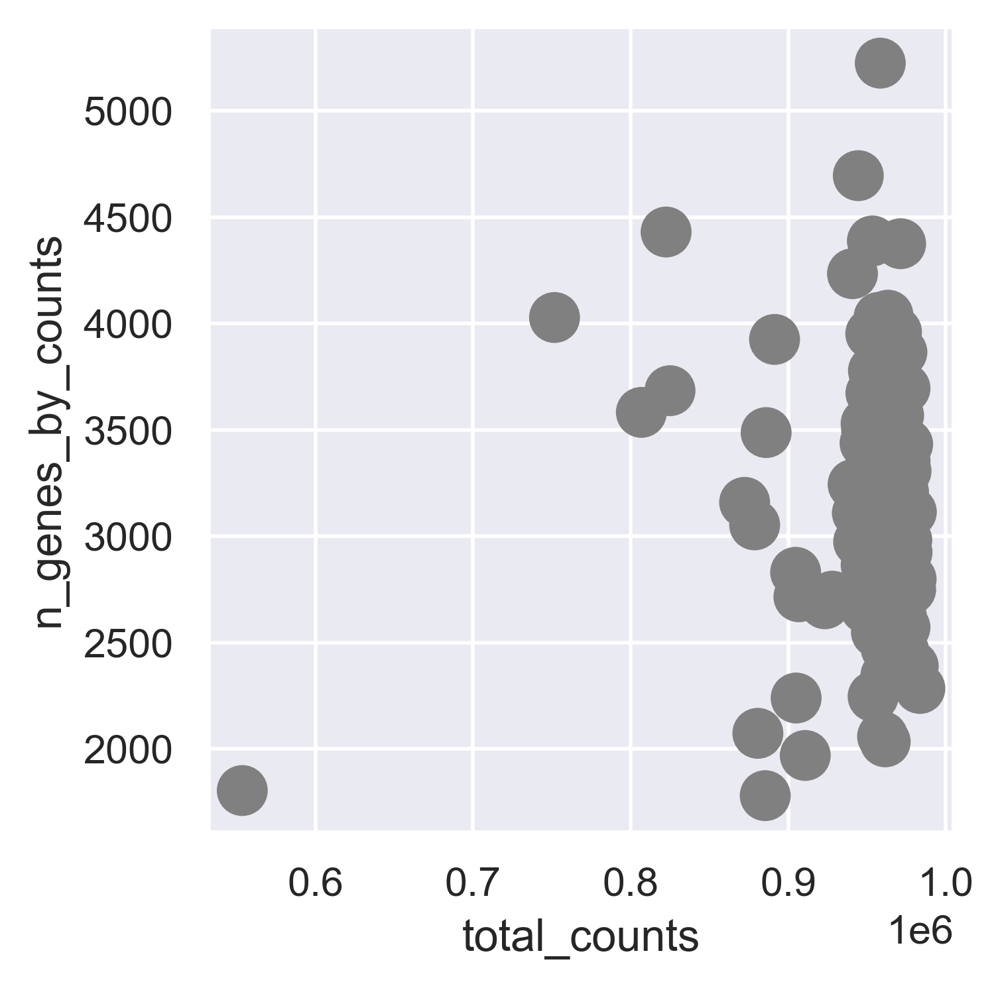

f:\tools\miniconda3\envs\deside3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... storing 'processed by Maxima enzyme' as categorical
... storing 'Lymph node' as categorical
... storing 'classified  as cancer cell' as categorical
... storing 'classified as non-cancer cells' as categorical
... storing 'non-cancer cell type' as categorical
... storing 'sample_id' as categorical


   The shape of adata after filtering is: (157, 8894)
#----------------------------------------------
Deal with HN13...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (90, 23686)


<Figure size 3000x600 with 0 Axes>

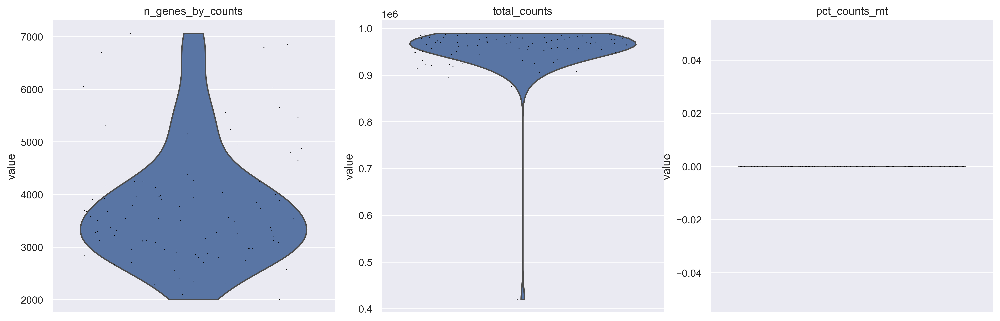

<Figure size 1600x1200 with 0 Axes>

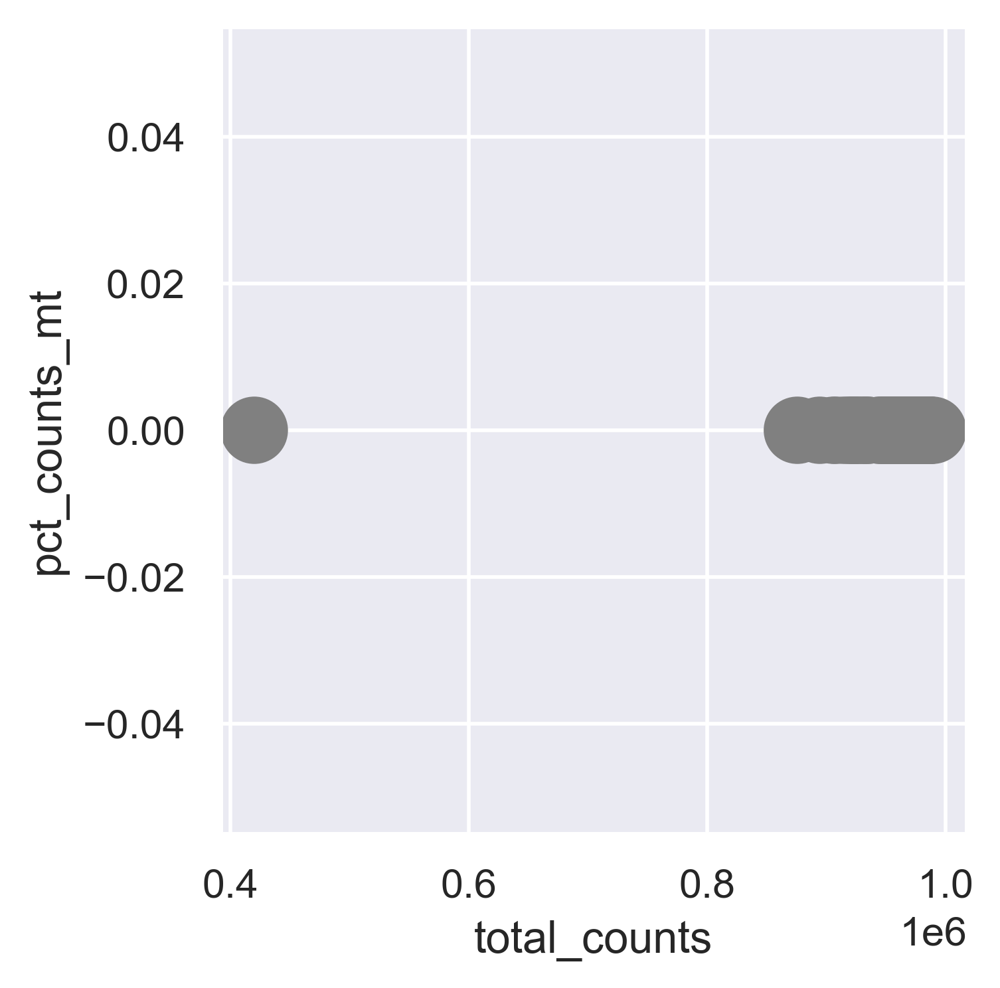

<Figure size 1600x1200 with 0 Axes>

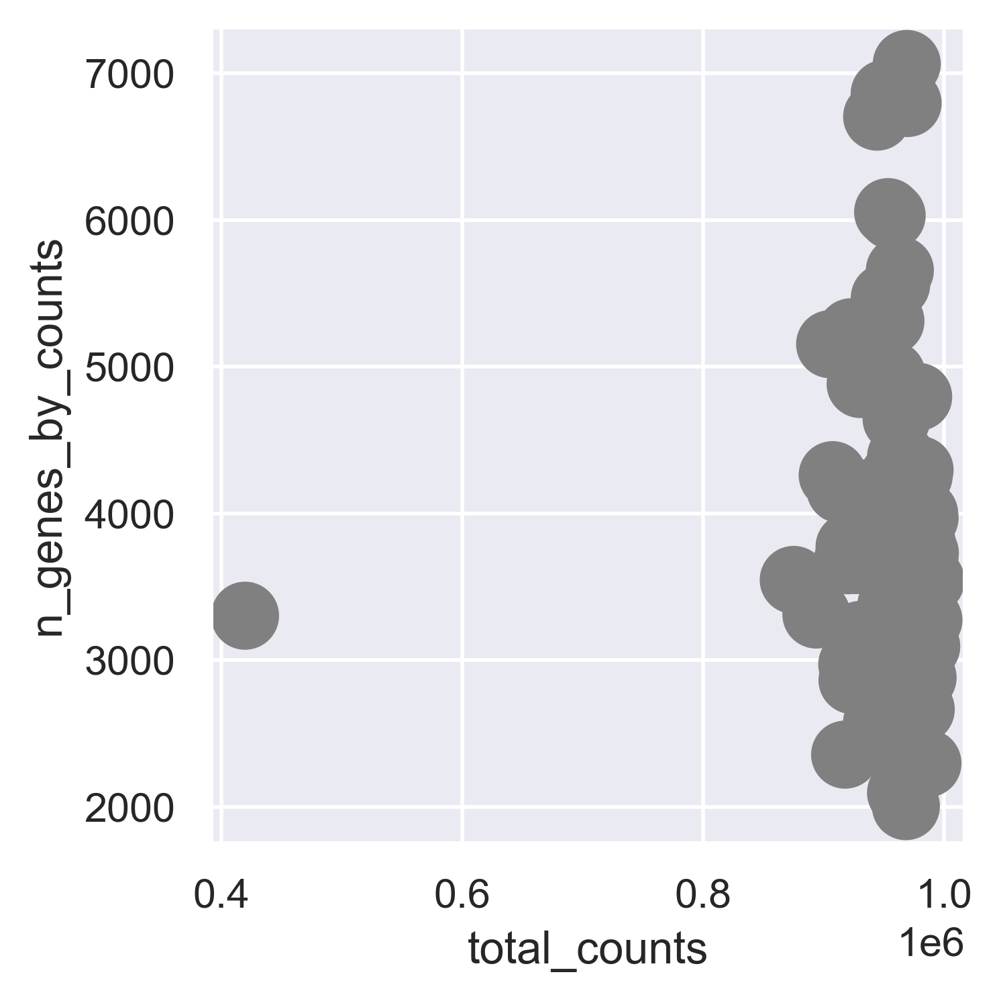

f:\tools\miniconda3\envs\deside3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... storing 'processed by Maxima enzyme' as categorical
... storing 'Lymph node' as categorical
... storing 'classified  as cancer cell' as categorical
... storing 'classified as non-cancer cells' as categorical
... storing 'non-cancer cell type' as categorical
... storing 'sample_id' as categorical


   The shape of adata after filtering is: (90, 9896)
#----------------------------------------------
Deal with HN10...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (89, 23686)


<Figure size 3000x600 with 0 Axes>

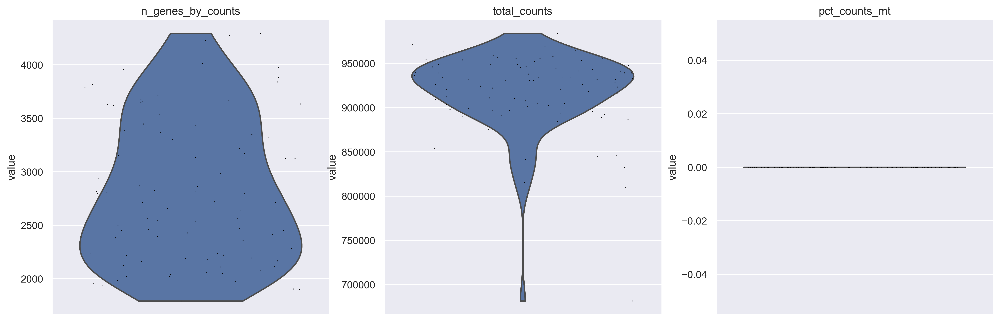

<Figure size 1600x1200 with 0 Axes>

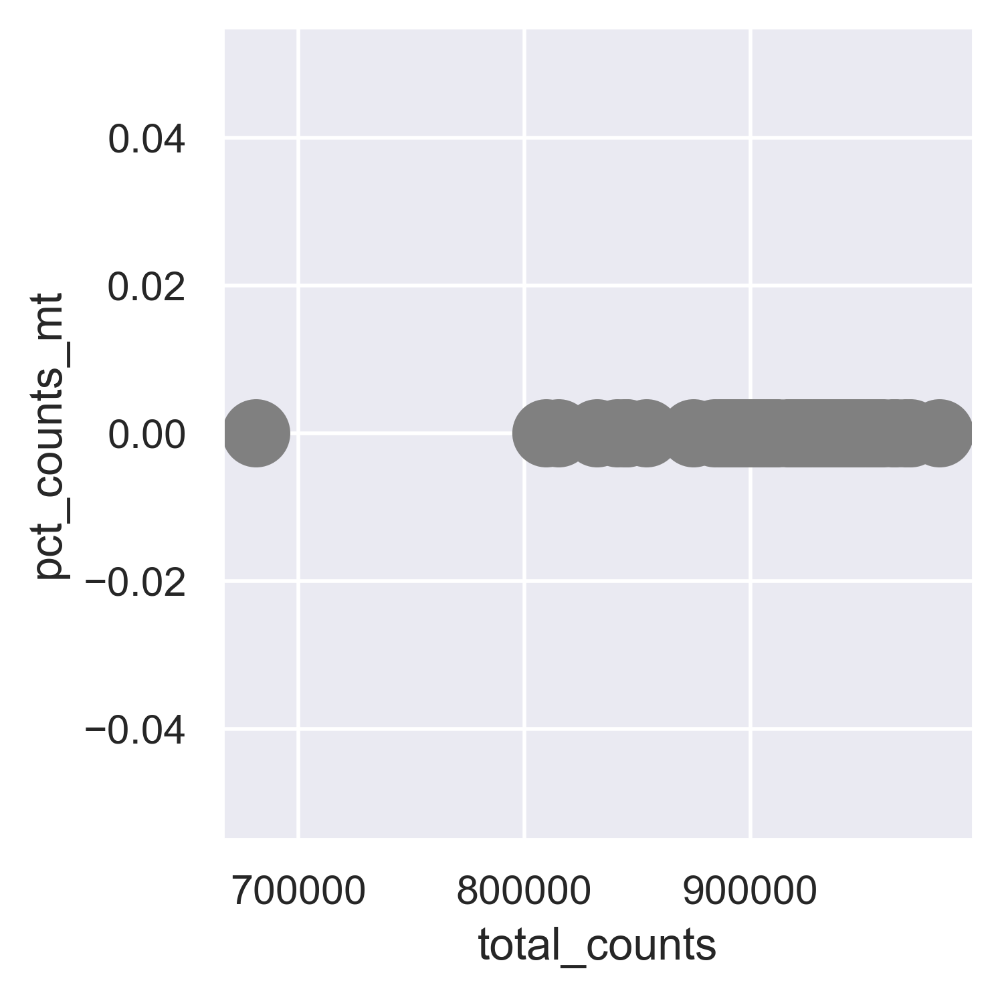

<Figure size 1600x1200 with 0 Axes>

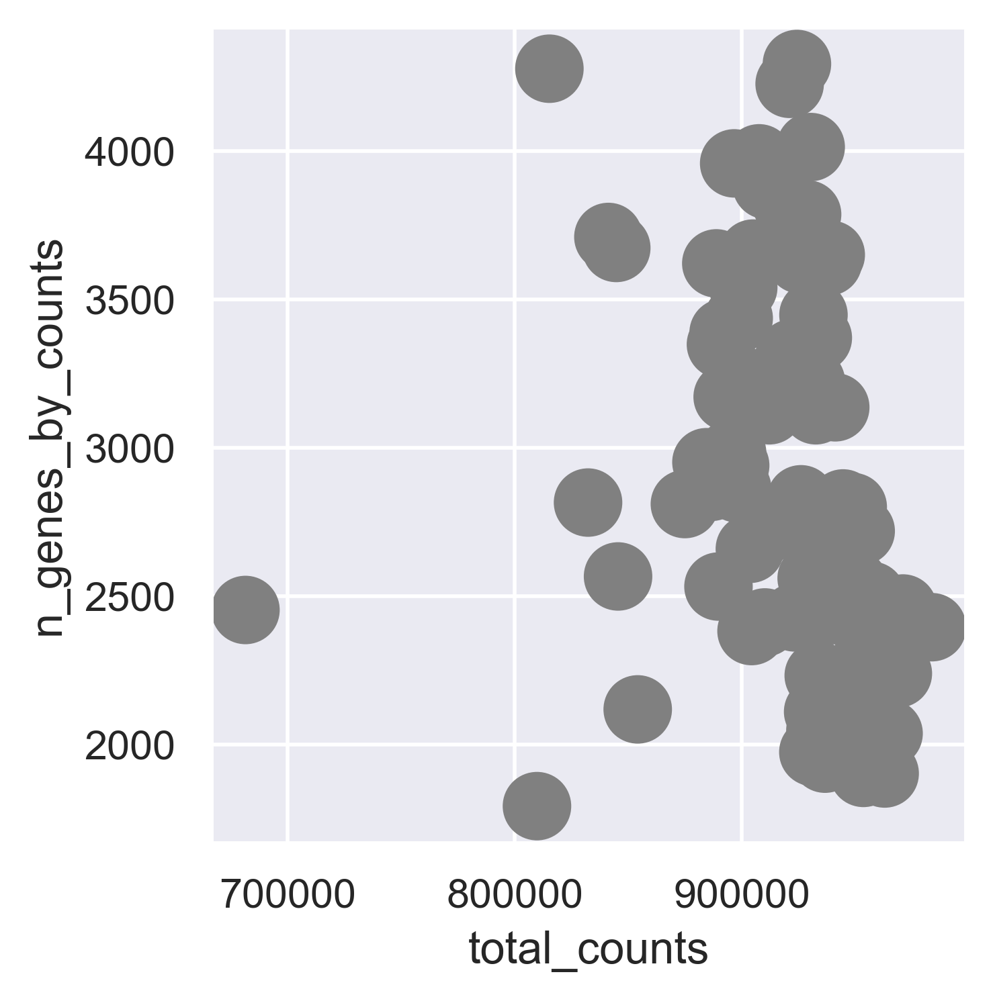

f:\tools\miniconda3\envs\deside3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... storing 'processed by Maxima enzyme' as categorical
... storing 'Lymph node' as categorical
... storing 'classified  as cancer cell' as categorical
... storing 'classified as non-cancer cells' as categorical
... storing 'non-cancer cell type' as categorical
... storing 'sample_id' as categorical


   The shape of adata after filtering is: (89, 7152)
#----------------------------------------------
Deal with HN6...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (308, 23686)


<Figure size 3000x600 with 0 Axes>

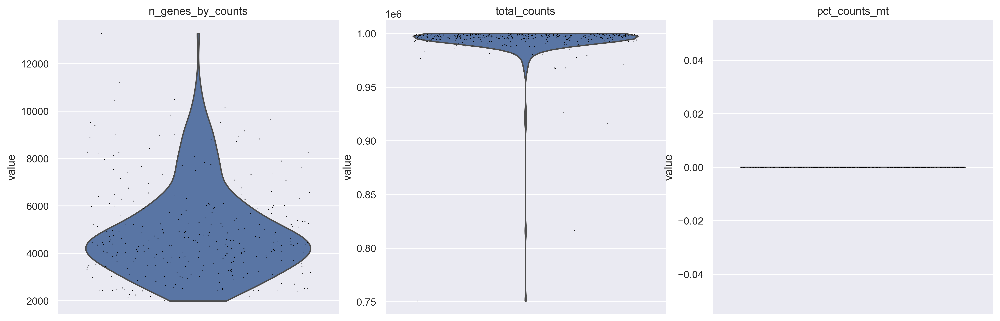

<Figure size 1600x1200 with 0 Axes>

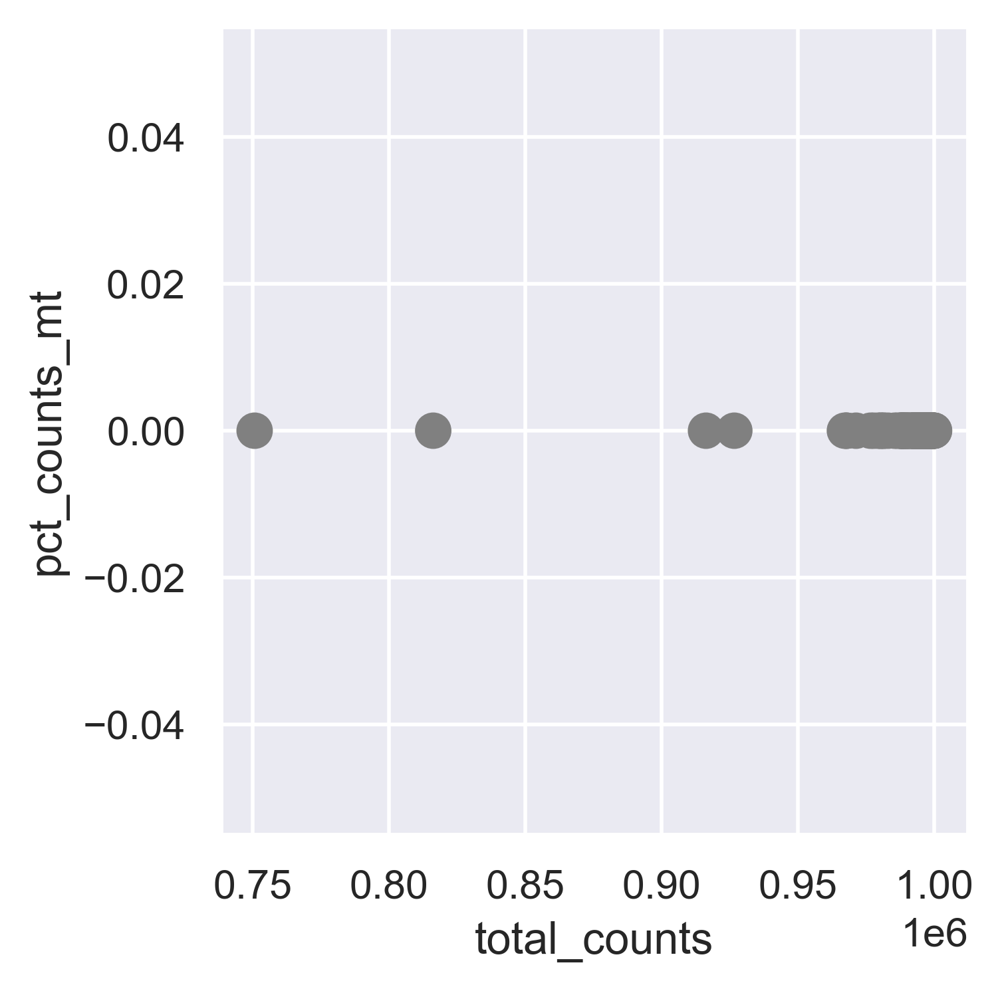

<Figure size 1600x1200 with 0 Axes>

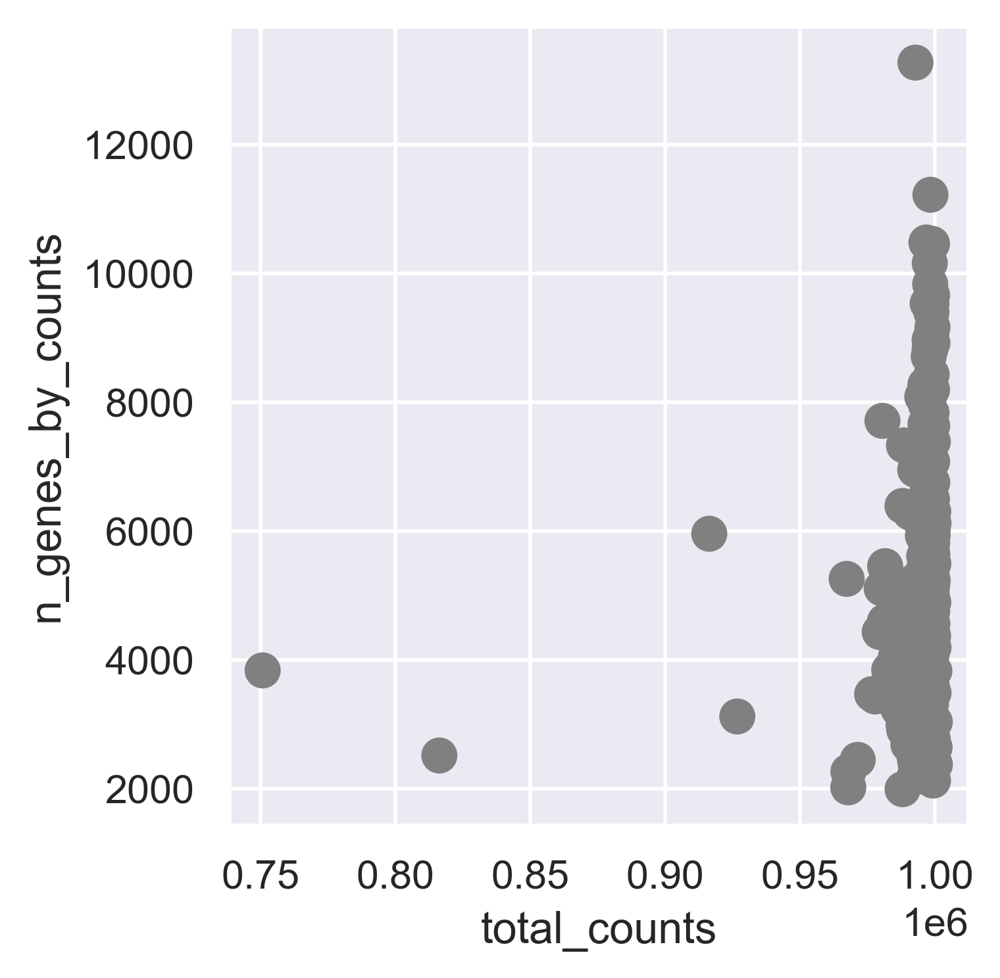

f:\tools\miniconda3\envs\deside3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... storing 'processed by Maxima enzyme' as categorical
... storing 'Lymph node' as categorical
... storing 'classified  as cancer cell' as categorical
... storing 'classified as non-cancer cells' as categorical
... storing 'non-cancer cell type' as categorical
... storing 'sample_id' as categorical


   The shape of adata after filtering is: (282, 15207)
#----------------------------------------------
Deal with HN5...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (370, 23686)


<Figure size 3000x600 with 0 Axes>

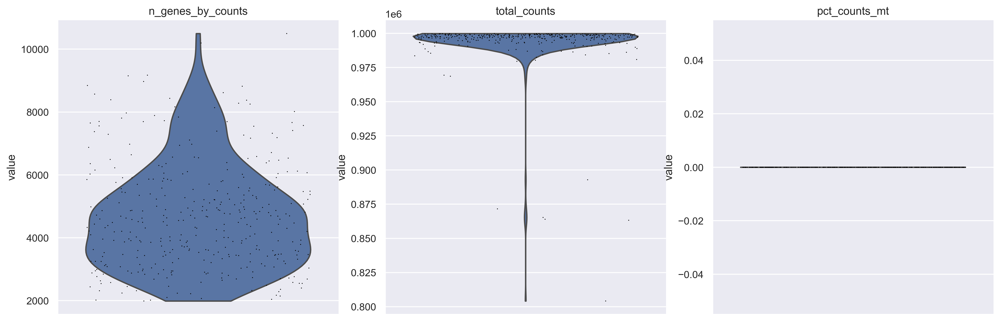

<Figure size 1600x1200 with 0 Axes>

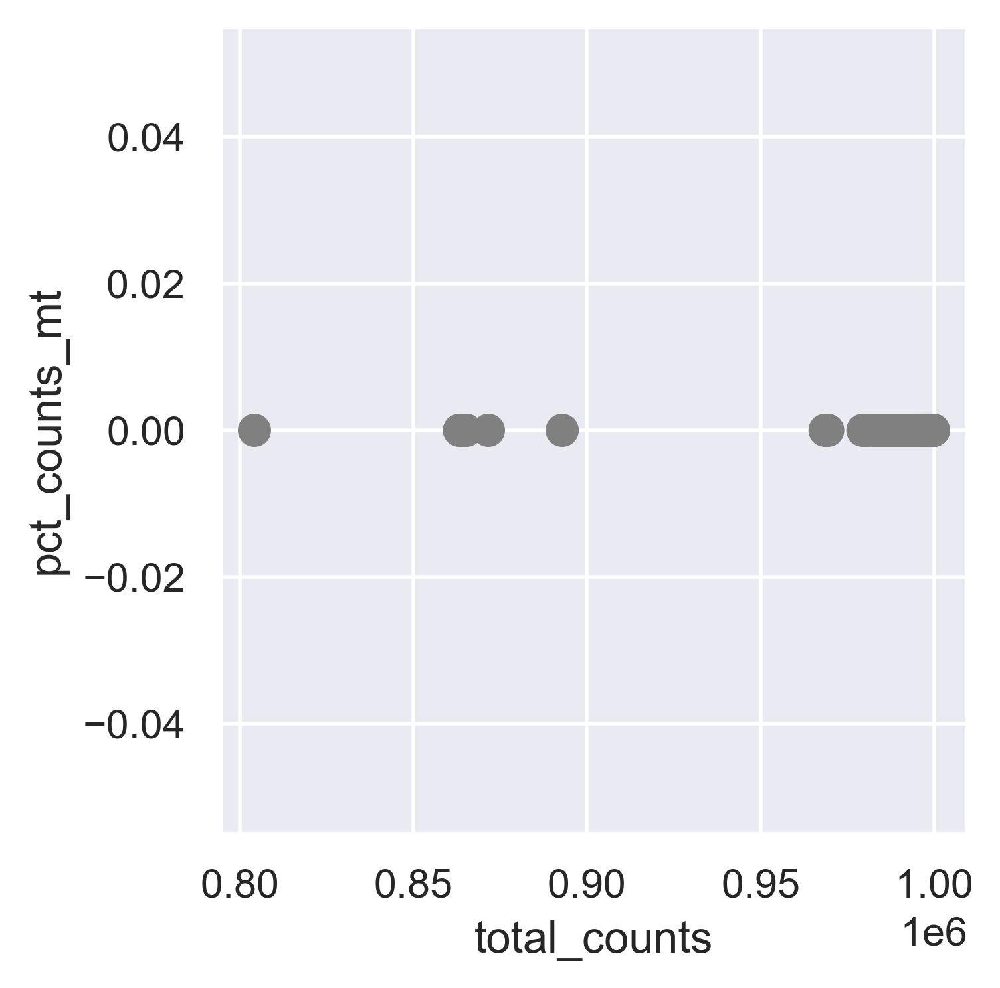

<Figure size 1600x1200 with 0 Axes>

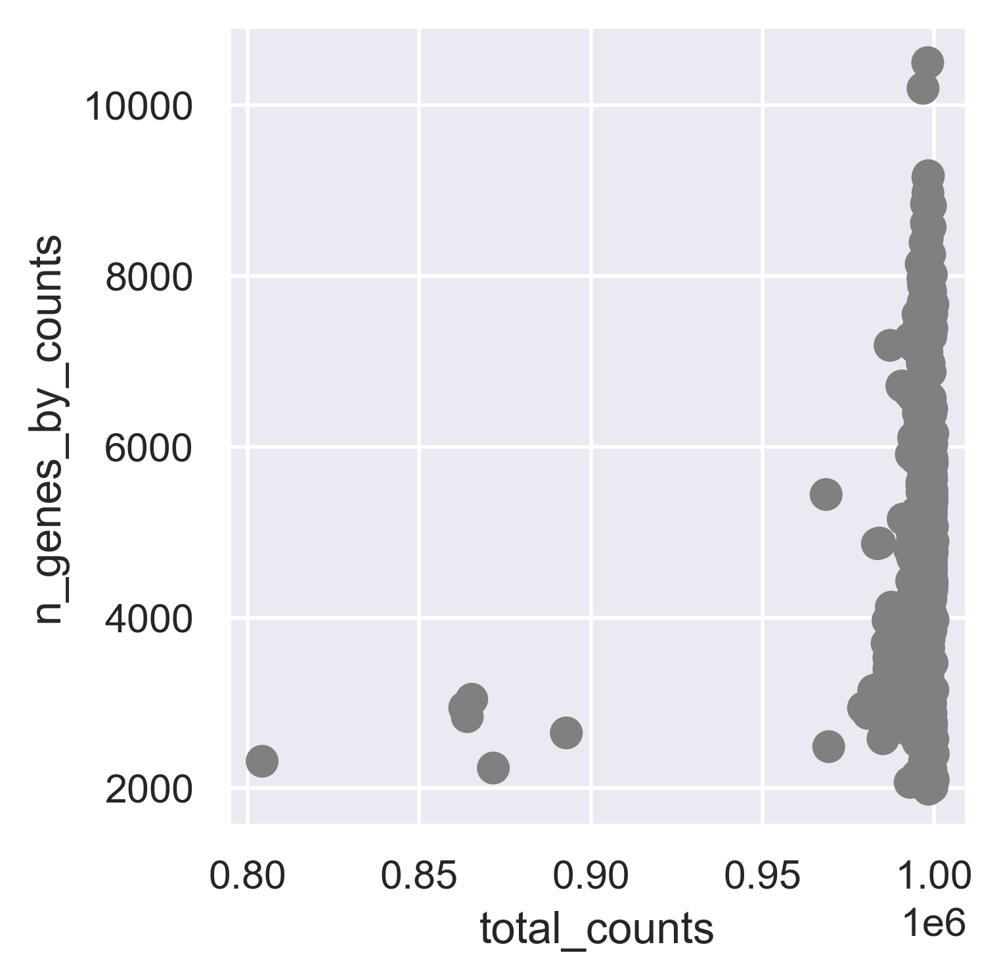

f:\tools\miniconda3\envs\deside3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... storing 'processed by Maxima enzyme' as categorical
... storing 'Lymph node' as categorical
... storing 'classified  as cancer cell' as categorical
... storing 'classified as non-cancer cells' as categorical
... storing 'non-cancer cell type' as categorical
... storing 'sample_id' as categorical


   The shape of adata after filtering is: (353, 15168)
#----------------------------------------------
Deal with HN8...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (104, 23686)


<Figure size 3000x600 with 0 Axes>

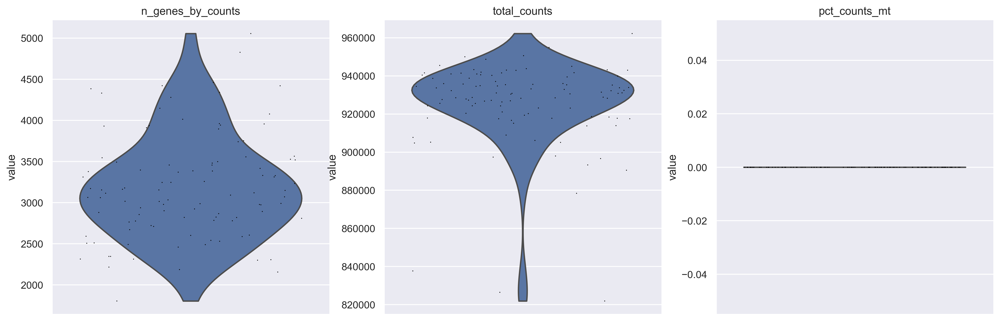

<Figure size 1600x1200 with 0 Axes>

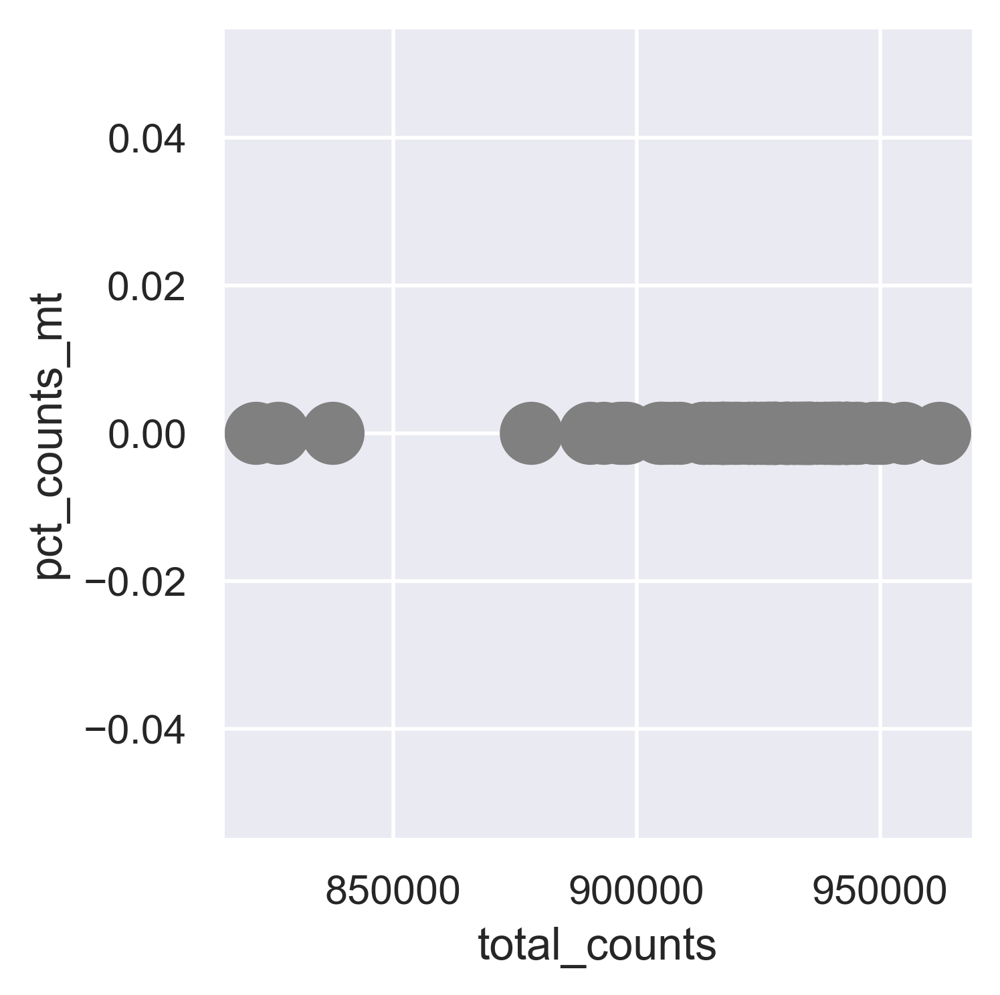

<Figure size 1600x1200 with 0 Axes>

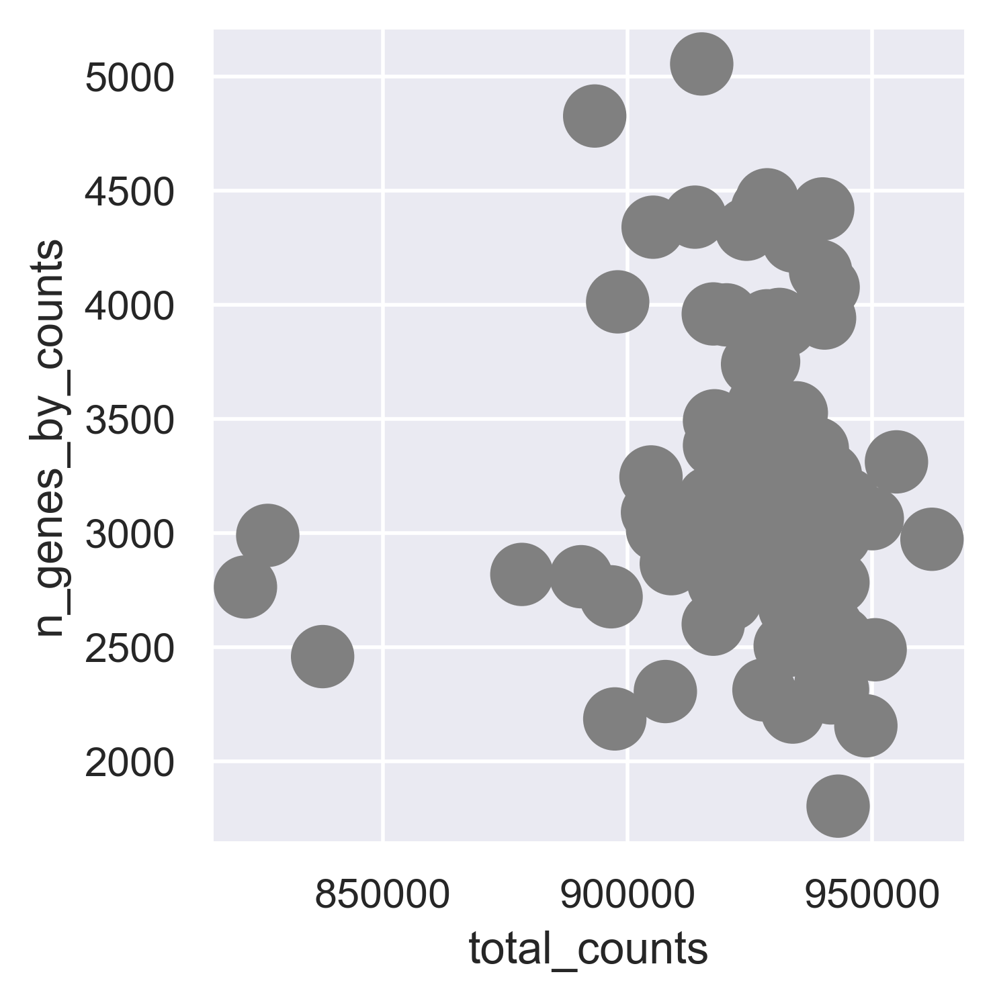

   The shape of adata after filtering is: (104, 8352)


f:\tools\miniconda3\envs\deside3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [16]:
for _file in all_files:
    if _file not in ['HN7', 'HN23']:  # remove samples that only have little cells
        print('#----------------------------------------------')
        print('Deal with {}...'.format(_file))
        current_sample = all_dataset[all_dataset.obs['sample_id']==_file, :]
        print(type(current_sample.X))
        current_sample_normalized = normalize_mtx(adata=current_sample, result_dir=result_dir, prefix='', fig_prefix=_file, target_sum=1e6,
                                                  max_n_genes_by_counts=8000, max_pct_counts_mt=10, max_total_counts=1e6+100, log_base=2, 
                                                  filter_genes=True, min_cells=10)
        current_sample_normalized.write(os.path.join(result_dir, _file+'_raw.h5ad'))

In [17]:
sample2dataset = {}
for _file in all_files:
    if _file not in ['HN7', 'HN23']:  # remove samples only have little cells
        current_file_path = os.path.join(result_dir, _file + '_raw.h5ad')
        current_dataset = sc.read_h5ad(current_file_path, backed=None)
        if current_dataset.shape[0] >= 1:
            current_dataset.obs['sample_id'] = _file    
            sample2dataset[_file] = current_dataset
        else:
            print('Remove file {} with shape: {}'.format(_file, current_dataset.shape()))

In [18]:
sample2dataset['HN5'].obs

,processed by Maxima enzyme,Lymph node,classified as cancer cell,classified as non-cancer cells,non-cancer cell type,sample_id,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt
HNSCC5_p3_HNSCC5_P3_D09,0,0,0,1,Macrophage,HN5,3320,3290,998308.1250,0.0,0.0
HNSCC5_p3_HNSCC5_P3_E10,0,0,0,1,Fibroblast,HN5,7638,7548,995384.9375,0.0,0.0
HNSCC5_p3_HNSCC5_P3_A10,0,0,0,1,Macrophage,HN5,3726,3697,986378.6250,0.0,0.0
HNSCC5_p3_HNSCC5_P3_E03,0,0,1,0,0,HN5,6411,6385,999127.6875,0.0,0.0
HNSCC5_p3_HNSCC5_P3_E09,0,0,0,1,Endothelial,HN5,5254,5153,991057.0000,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...
HNSCC5_p15_HNSCC5_P15_G06,1,1,1,0,0,HN5,7023,6976,998614.3125,0.0,0.0
HNSCC5_p15_HNSCC5_P15_A05,1,1,0,1,Endothelial,HN5,7047,6975,996628.5000,0.0,0.0
HNSCC5_p15_HNSCC5_P15_E01,1,1,0,1,Endothelial,HN5,6747,6641,992828.1875,0.0,0.0
HNSCC5_p15_HNSCC5_P15_A07,1,1,0,1,Fibroblast,HN5,5934,5853,994981.3750,0.0,0.0


In [19]:
sample2dataset['HN8']

AnnData object with n_obs × n_vars = 104 × 8352
    obs: 'processed by Maxima enzyme', 'Lymph node', 'classified  as cancer cell', 'classified as non-cancer cells', 'non-cancer cell type', 'sample_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'log1p'

### 2 mergering all samples together
- https://anndata.readthedocs.io/en/latest/anndata.AnnData.concatenate.html

In [20]:
len(sample2dataset)

16

In [21]:
all_dataset = None
all_dirs = list(sample2dataset.keys())
for i in range(len(sample2dataset)-1):
    print('dealing with {}'.format(all_dirs[i]))
    next_dataset = sample2dataset[all_dirs[i+1]]
    if all_dataset is None:
        current_dataset = sample2dataset[all_dirs[i]]
        all_dataset = current_dataset.concatenate(next_dataset, index_unique=None, join='outer')
    else:
        all_dataset = all_dataset.concatenate(next_dataset, index_unique=None, join='outer')

dealing with HN28
dealing with HN26
dealing with HN25
dealing with HN24
dealing with HN22
dealing with HN18
dealing with HN20
dealing with HN17
dealing with HN
dealing with HN16
dealing with HN12
dealing with HN13
dealing with HN10
dealing with HN6
dealing with HN5


In [22]:
all_dataset.obs

,processed by Maxima enzyme,Lymph node,classified as cancer cell,classified as non-cancer cells,non-cancer cell type,sample_id,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,batch
HN28_P15_D06_S330_comb,1,1,0,1,Fibroblast,HN28,4286,4257,998356.1875,0.0,0.0,0
HN28_P6_G05_S173_comb,1,0,0,1,Fibroblast,HN28,2723,2712,998954.0000,0.0,0.0,0
HN28_P15_G06_S366_comb,1,1,0,1,Fibroblast,HN28,3417,3394,997703.0000,0.0,0.0,0
HN28_P6_D09_S141_comb,1,0,0,1,Fibroblast,HN28,2198,2179,994976.6875,0.0,0.0,0
HN28_P6_A09_S105_comb,1,0,0,1,Fibroblast,HN28,3043,3015,996102.3125,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
HNSCC8_RLN_HNSCC8_RLNI_B06,0,0,0,1,Fibroblast,HN8,4543,3960,917515.3125,0.0,0.0,1
HNSCC8_RLN_HNSCC8_RLNI_E04,0,0,0,1,-Fibroblast,HN8,4359,3956,920212.1875,0.0,0.0,1
HNSCC8_RLN_HNSCC8_RLNI_A10,0,0,0,1,Mast,HN8,2645,2459,837684.8750,0.0,0.0,1
HNSCC8_RLN_HNSCC8_RLNI_H09,0,0,0,1,T cell,HN8,3869,3556,928248.6250,0.0,0.0,1


In [23]:
all_dataset.var.head(2)

,n_cells-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,mt-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,n_cells_by_counts-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,mean_counts-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,pct_dropout_by_counts-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,total_counts-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,n_cells-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0,mt-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0,n_cells_by_counts-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0,mean_counts-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0,...,n_cells_by_counts-1-0,mean_counts-1-0,pct_dropout_by_counts-1-0,total_counts-1-0,n_cells-1,mt-1,n_cells_by_counts-1,mean_counts-1,pct_dropout_by_counts-1,total_counts-1
gene_name,,,,,,,,,,,,,,,,,,,,,
A1BG,59.0,False,59.0,3.822024,90.422078,2354.366699,87.0,False,87.0,3.701198,...,76.0,4.413522,79.459459,1633.003296,NaN,NaN,NaN,NaN,NaN,NaN
A1BG-AS1,42.0,False,42.0,5.157976,93.181818,3177.312988,41.0,False,41.0,3.660891,...,34.0,3.527128,90.810811,1305.037354,NaN,NaN,NaN,NaN,NaN,NaN


In [24]:
all_dataset.var.drop(columns=all_dataset.var.columns.to_list()[1:-1], inplace=True)
all_dataset.var.head(2), all_dataset.var.shape

(           n_cells-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0  total_counts-1
 gene_name                                                       
 A1BG                                        59.0             NaN
 A1BG-AS1                                    42.0             NaN,
 (18122, 2))

In [25]:
all_dataset

AnnData object with n_obs × n_vars = 5741 × 18122
    obs: 'processed by Maxima enzyme', 'Lymph node', 'classified  as cancer cell', 'classified as non-cancer cells', 'non-cancer cell type', 'sample_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch'
    var: 'n_cells-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'total_counts-1'

In [26]:
all_dataset.write(os.path.join(result_dir, 'all_HNSCC_Puram_Cell_2017_merged.h5ad'))

... storing 'processed by Maxima enzyme' as categorical
... storing 'Lymph node' as categorical
... storing 'classified  as cancer cell' as categorical
... storing 'non-cancer cell type' as categorical
... storing 'sample_id' as categorical


In [27]:
all_dataset = sc.read_h5ad(os.path.join(result_dir, 'all_HNSCC_Puram_Cell_2017_merged.h5ad'))
all_dataset

AnnData object with n_obs × n_vars = 5741 × 18122
    obs: 'processed by Maxima enzyme', 'Lymph node', 'classified  as cancer cell', 'classified as non-cancer cells', 'non-cancer cell type', 'sample_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch'
    var: 'n_cells-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'total_counts-1'

#### Filter genes by annotation file
- only keep `protein_coding` genes

In [28]:
gene_list_in_bulk = pd.read_csv('../datasets/TCGA/gencode.gene.info.v22.tsv', index_col=0, sep='\t')
gene_list_in_bulk = gene_list_in_bulk.loc[gene_list_in_bulk['gene_type'] == 'protein_coding', :].copy()
print(gene_list_in_bulk.shape)
gene_list_in_bulk.head(2)

(19814, 11)


,gene_name,seqname,start,end,strand,gene_type,gene_status,havana_gene,full_length,exon_length,exon_num
gene_id,,,,,,,,,,,
ENSG00000206557.5,TRIM71,chr3,32818018,32897826,+,protein_coding,KNOWN,OTTHUMG00000155778.3,79809,8685,4
ENSG00000183813.6,CCR4,chr3,32951574,32956349,+,protein_coding,KNOWN,OTTHUMG00000130752.2,4776,3095,2


In [29]:
common_marker_gene = pd.read_csv('selected_marker_genes.csv', index_col=0)
print(common_marker_gene.shape)
common_marker_gene.head(2)

(125, 5)


,cell_type,subset,PMID,comment,core_marker
marker_gene,,,,,
IGHA2,B Cells,B Cells,31712411; 30523328,non-cancer cell,NaN
IGHM,B Cells,B Cells,31712411; 30523328,non-cancer cell,NaN


In [30]:
len(set(all_dataset.var.index) & set(gene_list_in_bulk['gene_name'])), len(set(all_dataset.var.index) & set(common_marker_gene.index)), gene_list_in_bulk.shape, all_dataset.var.shape

(15741, 111, (19814, 11), (18122, 2))

In [31]:
# genes in bulk gene list or marker genes
bulk_marker = set(gene_list_in_bulk['gene_name']) | set(common_marker_gene.index)
len(bulk_marker)

19714

In [32]:
all_dataset = all_dataset[:, all_dataset.var.index.isin(bulk_marker)]
all_dataset

View of AnnData object with n_obs × n_vars = 5741 × 15741
    obs: 'processed by Maxima enzyme', 'Lymph node', 'classified  as cancer cell', 'classified as non-cancer cells', 'non-cancer cell type', 'sample_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch'
    var: 'n_cells-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'total_counts-1'

### 3. Principal component analysis
- Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.

In [33]:
sc.tl.pca(all_dataset, svd_solver='arpack', n_comps=100, use_highly_variable=False, zero_center=False)

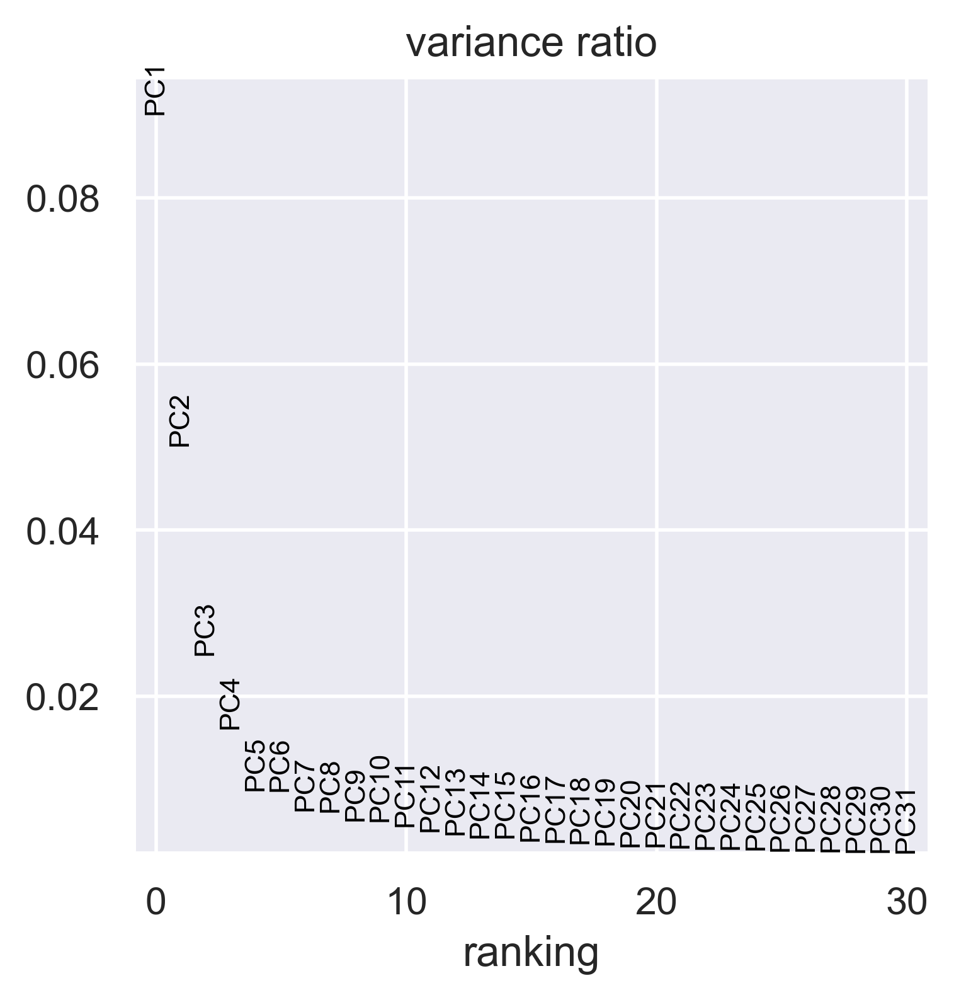

In [34]:
sc.pl.pca_variance_ratio(all_dataset, n_pcs=30)

In [35]:
all_dataset.obsm['X_pca'].shape

(5741, 100)

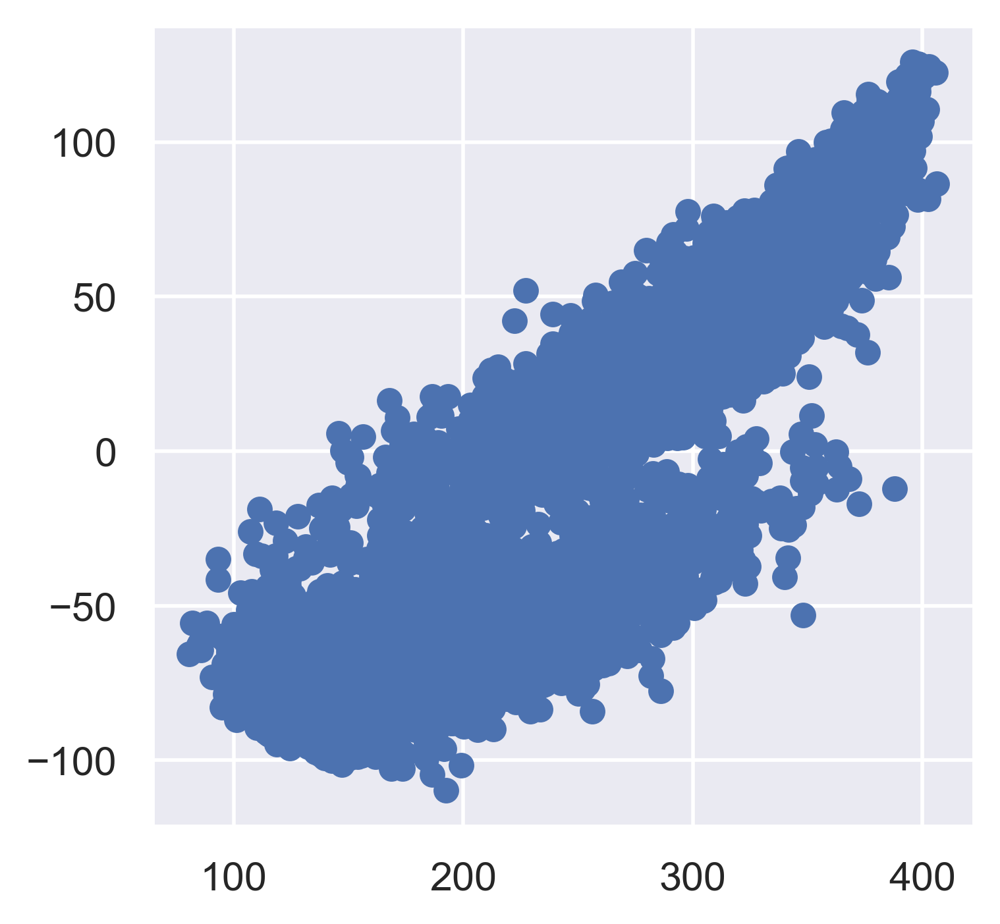

In [36]:
plt.scatter(all_dataset.obsm['X_pca'][:, 0], all_dataset.obsm['X_pca'][:, 1])

### 4. Computing the neighborhood graph and Embedding the neighborhood graph

In [37]:
sc.pp.neighbors(all_dataset, n_neighbors=10, n_pcs=40)

In [38]:
sc.tl.umap(all_dataset)

In [39]:
all_dataset

AnnData object with n_obs × n_vars = 5741 × 15741
    obs: 'processed by Maxima enzyme', 'Lymph node', 'classified  as cancer cell', 'classified as non-cancer cells', 'non-cancer cell type', 'sample_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch'
    var: 'n_cells-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'total_counts-1'
    uns: 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [40]:
sc.tl.leiden(all_dataset)

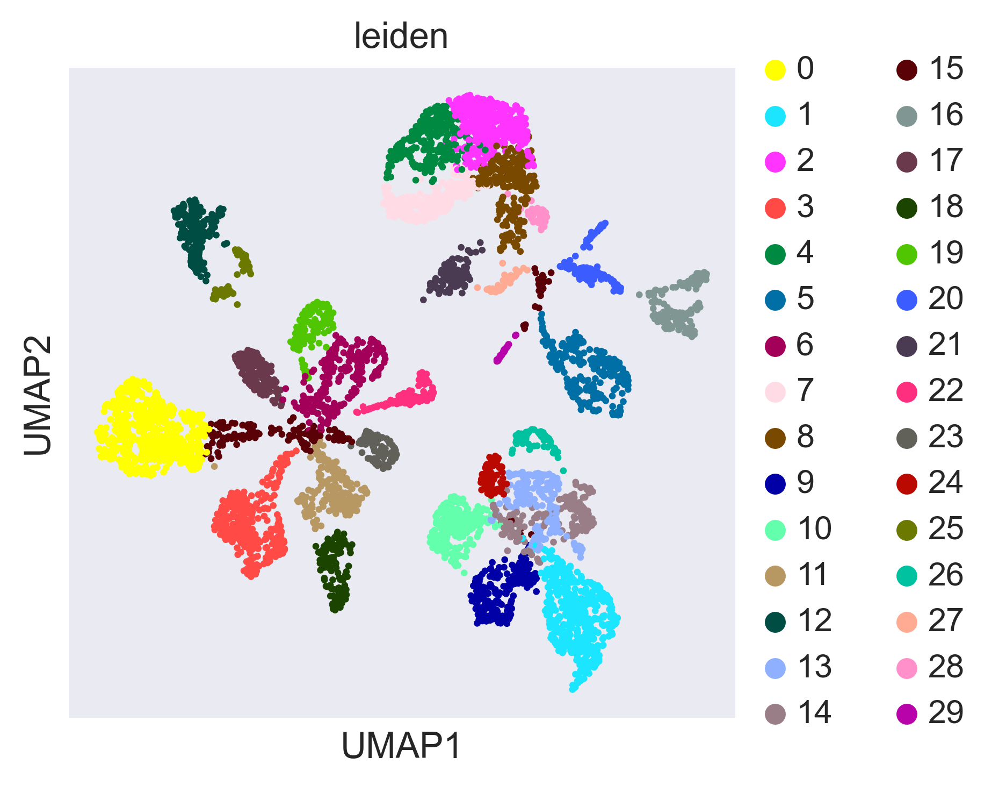

In [41]:
sc.pl.umap(all_dataset, color=['leiden'], save='before_batch_correct_umap_leiden.png')

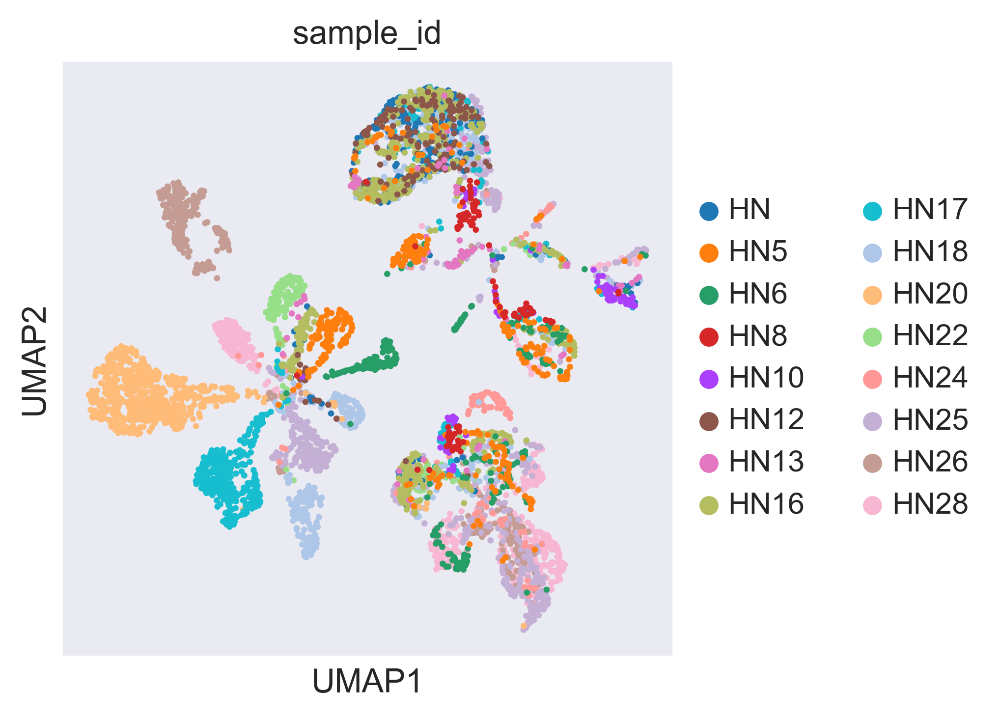

In [42]:
sc.pl.umap(all_dataset, color=['sample_id'], save='before_batch_correct_umap_batch.png')

In [43]:
all_dataset.write(os.path.join(file_path, 'preprocessing', 'all_HNSCC_Puram_Cell_2017_merged_before_batch_correction.h5ad'))

### 5. Batch effect correction by BBKNN
- https://scanpy-tutorials.readthedocs.io/en/latest/integrating-data-using-ingest.html#BBKNN

In [44]:
%%time
sc.external.pp.bbknn(all_dataset, batch_key='sample_id')

Wall time: 2.93 s


In [45]:
all_dataset

AnnData object with n_obs × n_vars = 5741 × 15741
    obs: 'processed by Maxima enzyme', 'Lymph node', 'classified  as cancer cell', 'classified as non-cancer cells', 'non-cancer cell type', 'sample_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden'
    var: 'n_cells-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'total_counts-1'
    uns: 'pca', 'neighbors', 'umap', 'leiden', 'leiden_colors', 'sample_id_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [46]:
%%time
sc.tl.umap(all_dataset)
sc.tl.leiden(all_dataset)

Wall time: 12.9 s


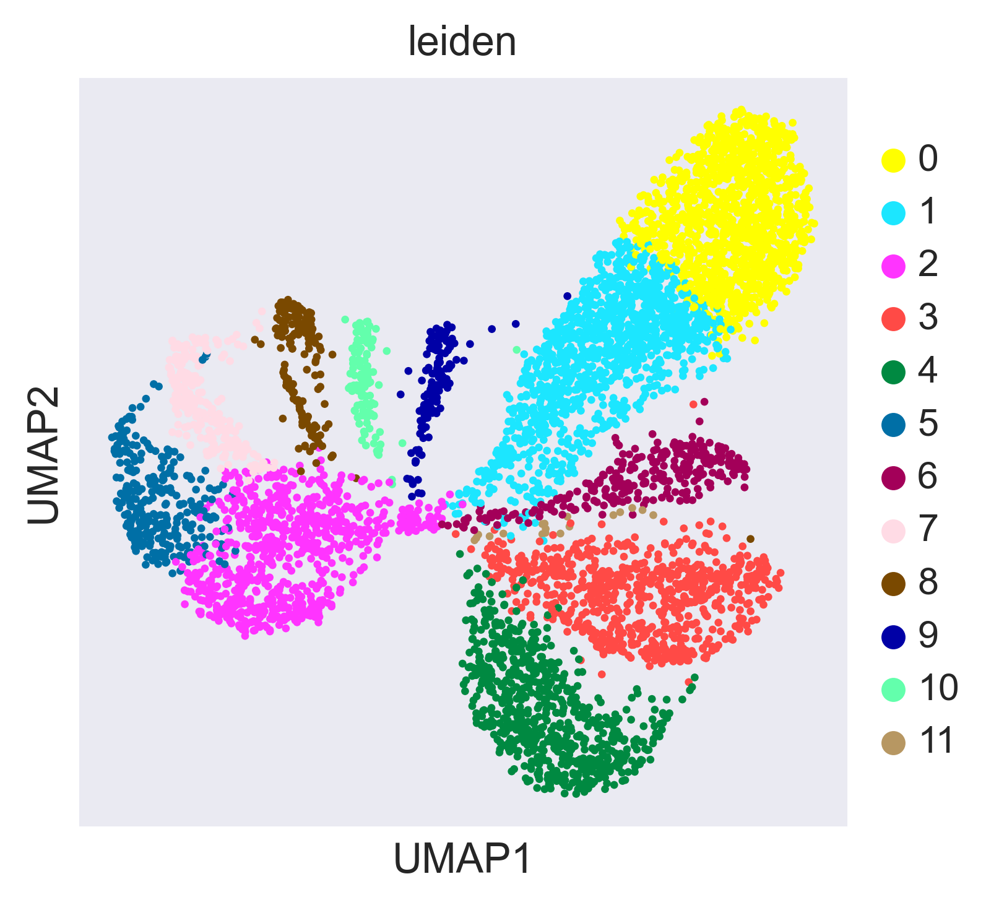

In [47]:
sc.pl.umap(all_dataset, color=['leiden'], save='after_batch_correct_umap_leiden.png')

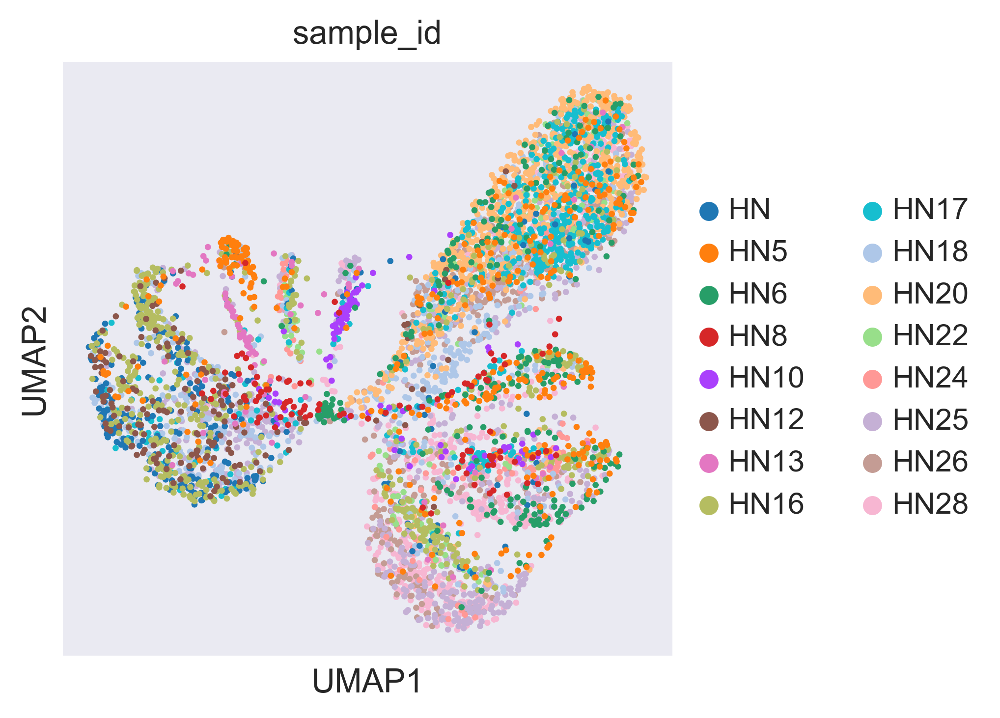

In [48]:
sc.pl.umap(all_dataset, color=['sample_id'], save='after_batch_correct_umap_batch.png')

In [49]:
all_dataset.write(os.path.join(file_path, 'preprocessing', 'all_HNSCC_Puram_Cell_2017_merged_after_batch_correction.h5ad'))

### 6. Finding marker genes

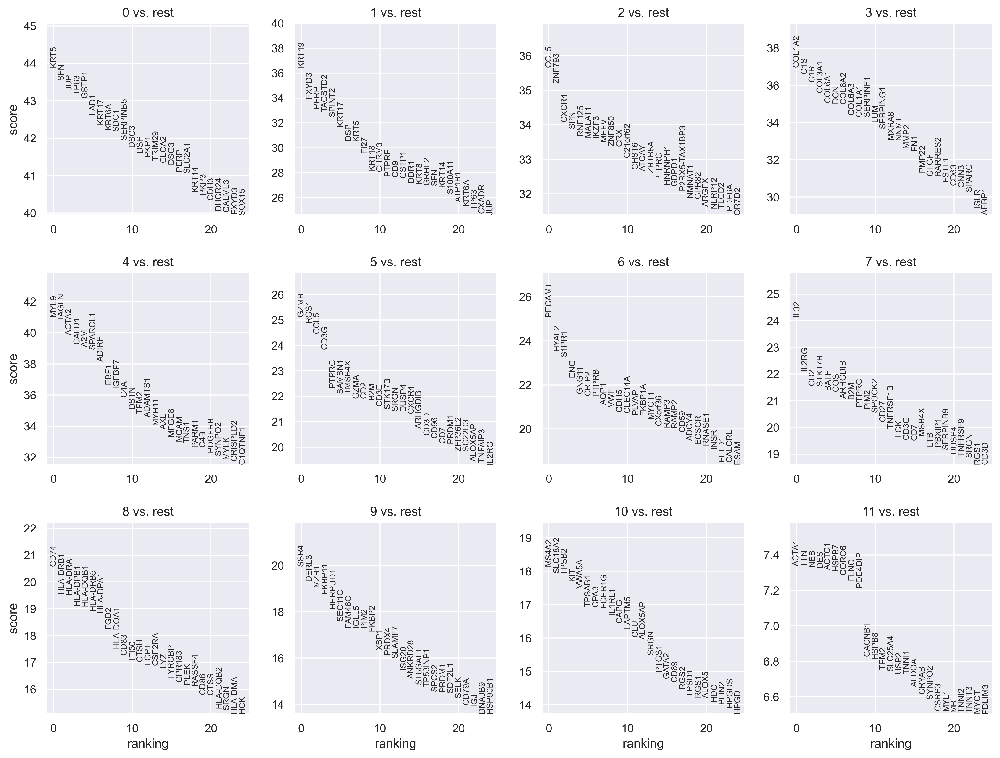

In [50]:
sc.tl.rank_genes_groups(all_dataset, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(all_dataset, n_genes=25, sharey=False)

In [51]:
top30 = pd.DataFrame(all_dataset.uns['rank_genes_groups']['names']).head(30)
top30

,0,1,2,3,4,5,6,7,8,9,10,11
0,KRT5,KRT19,CCL5,COL1A2,MYL9,GZMB,PECAM1,IL32,CD74,SSR4,MS4A2,ACTA1
1,SFN,FXYD3,ZNF793,C1S,TAGLN,RGS1,HYAL2,IL2RG,HLA-DRB1,DERL3,SLC18A2,TTN
2,JUP,PERP,CXCR4,C1R,ACTA2,CCL5,S1PR1,CD2,HLA-DRA,MZB1,TPSB2,NEB
3,TP63,TACSTD2,SPN,COL3A1,CALD1,CD3G,ENG,STK17B,HLA-DPB1,FKBP11,KIT,DES
4,GSTP1,SPINT2,RNF125,COL6A1,A2M,PTPRC,GNG11,BATF,HLA-DQB1,HERPUD1,VWA5A,ACTC1
5,LAD1,KRT17,MALAT1,DCN,SPARCL1,SAMSN1,CRIP2,ICOS,HLA-DRB5,SEC11C,TPSAB1,HSPB7
6,KRT17,DSP,IKZF3,COL6A2,ADIRF,TMSB4X,PTPRB,ARHGDIB,HLA-DPA1,FAM46C,CPA3,CORO6
7,KRT6A,KRT5,MEFV,COL6A3,EBF1,GZMA,AQP1,B2M,FGD2,IGLL5,FCER1G,FLNC
8,SDC1,IFI27,ZNF850,COL1A1,IGFBP7,CD2,VWF,PTPRC,HLA-DQA1,PIM2,IL1RL1,PDE4DIP
9,SERPINB5,KRT18,CRX,SERPINF1,C4A,B2M,CDH5,PIM2,CD83,FKBP2,CAPG,CACNB1


In [52]:
common_marker_gene = pd.read_csv('selected_marker_genes.csv', index_col=0)
common_marker_gene.head(2)

,cell_type,subset,PMID,comment,core_marker
marker_gene,,,,,
IGHA2,B Cells,B Cells,31712411; 30523328,non-cancer cell,NaN
IGHM,B Cells,B Cells,31712411; 30523328,non-cancer cell,NaN


In [53]:
for cluster_id in top30:
    print('Current cluster id: {}'.format(cluster_id))
    print(top30.loc[:, [cluster_id]].merge(common_marker_gene, left_on=cluster_id, right_index=True).iloc[:, range(2)])

Current cluster id: 0
        0         cell_type
0    KRT5  Epithelial cells
6   KRT17  Epithelial cells
26   CDH1  Epithelial cells
Current cluster id: 1
        1         cell_type
0   KRT19  Epithelial cells
0   KRT19  Epithelial cells
0   KRT19  Epithelial cells
5   KRT17  Epithelial cells
7    KRT5  Epithelial cells
9   KRT18  Epithelial cells
9   KRT18  Epithelial cells
15   KRT8  Epithelial cells
Current cluster id: 2
      2 cell_type
0  CCL5     CD8 T
Current cluster id: 3
         3    cell_type
0   COL1A2  Fibroblasts
3   COL3A1  Fibroblasts
5      DCN  Fibroblasts
8   COL1A1  Fibroblasts
10     LUM  Fibroblasts
Current cluster id: 4
      4    cell_type
0  MYL9  Fibroblasts
Current cluster id: 5
         5   cell_type
0     GZMB  CD8 T / DC
2     CCL5       CD8 T
7     GZMA       CD8 T
8      CD2     T Cells
10    CD3E     T Cells
16    CD3D     T Cells
28  CXCL13       CD4 T
Current cluster id: 6
        6          cell_type
3     ENG  Endothelial Cells
8     VWF  Endothe

In [57]:
marker_genes1 = ["PDCD1", "IFNG", "CD2", "CD3D", "CD3E", # T Cell
                 "BATF", "ICOS", "IL7R", "SELL", "TNFRSF4", "CXCL13", "CXCR5", "MAF", "IL12RB2", "STAT4", "CREM", "IRF4", "NR4A2", 
                 "GATA3", "STAT6", "TCF7", "IKZF2", "IL2RA", "TGFB1", "TGFB3", "TGFBR1", "CD28", "TNFRSF14", "TNFRSF9", 
                 "FOXP3", "CTLA4", "TIGIT", "CCR7", "CD4",  # CD4 T
                 "CX3CR1", "CCL5", "CD8A", "CD8B", "GZMA", "LAYN", "LAG3", "GZMB", "GNLY", "NKG7", "PRF1", # CD8 T
                 "NCAM1", "XCL1", "KLRD1", "SAMD3", "TBX21"]  # NK

In [58]:
marker_genes2 = ["BANK1", "CD19", "CD22", "CD79A", "FCRL5", "FCRLA", "MS4A1", "SLAMF7", # B Cells
                 "CLEC10A", "LAMP3", "CD80", "CD83", "CLEC4C", "IRF8", "MZB1", "CD40", # DC
                 "CDH5", "CLDN5", "ENG", "PLVAP", "VWF", # Endothelial Cells
                 "COL1A1", "COL1A2", "COL3A1", "DCN", "FAP", "LUM", "MYL9",  # Fibroblasts
                 "AIF1", "CD14", "CD163", "CD68", "CTSB", "FCGR2A", "FCGR3B", "LYZ", "MARCO", "MS4A7", "FCGR3A", # Macrophages
                 "CMA1", "MS4A2", "TPSAB1", # Mast Cells
                 "CFLAR", "CSF3R", "CXCR2", "FPR1", "S100A8", "S100A9", "SLC25A37", # Neutrophils
                 "CDH1", "EPCAM", "KRT18", "KRT19", 'KRT5', 'KRT8']  # Epithelial cells

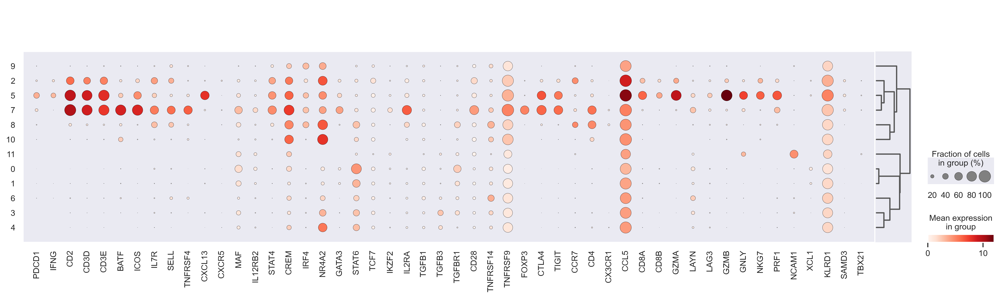

In [59]:
sc.pl.dotplot(all_dataset, marker_genes1, groupby='leiden', save='marker_genes_dotplot1.png', dendrogram=True)

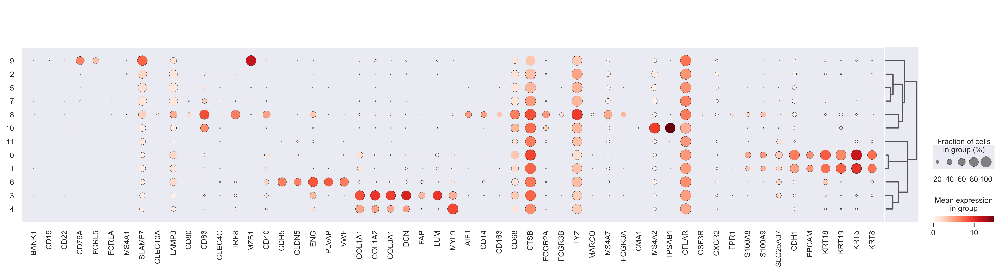

In [60]:
sc.pl.dotplot(all_dataset, marker_genes2, groupby='leiden', save='marker_genes_dotplot2.png', dendrogram=True)

In [61]:
# Exhausted CD8 T (Tex)
# follicular T helper (Tfh)
# Plasmacytoid dendritic cells (pDC)
new_cluster_names = {
    0: 'Epithelial Cells (1)',
    1: 'Epithelial Cells (2)',
    2: 'CD8 T (1)',
    3: 'Fibroblasts (1)',
    4: 'Fibroblasts (2)',
    5: 'CD8 T (2)',
    6: 'Endothelia Cells',
    7: 'CD4 T',
    8: 'DC / Macrophages',
    9: 'B Cells',
    10: 'Mast Cells',
    11: "11"
}
new_cluster_names_val = list(new_cluster_names.values())
print(new_cluster_names_val)
all_dataset.rename_categories('leiden', new_cluster_names_val)

['Epithelial Cells (1)', 'Epithelial Cells (2)', 'CD8 T (1)', 'Fibroblasts (1)', 'Fibroblasts (2)', 'CD8 T (2)', 'Endothelia Cells', 'CD4 T', 'DC / Macrophages', 'B Cells', 'Mast Cells', '11']


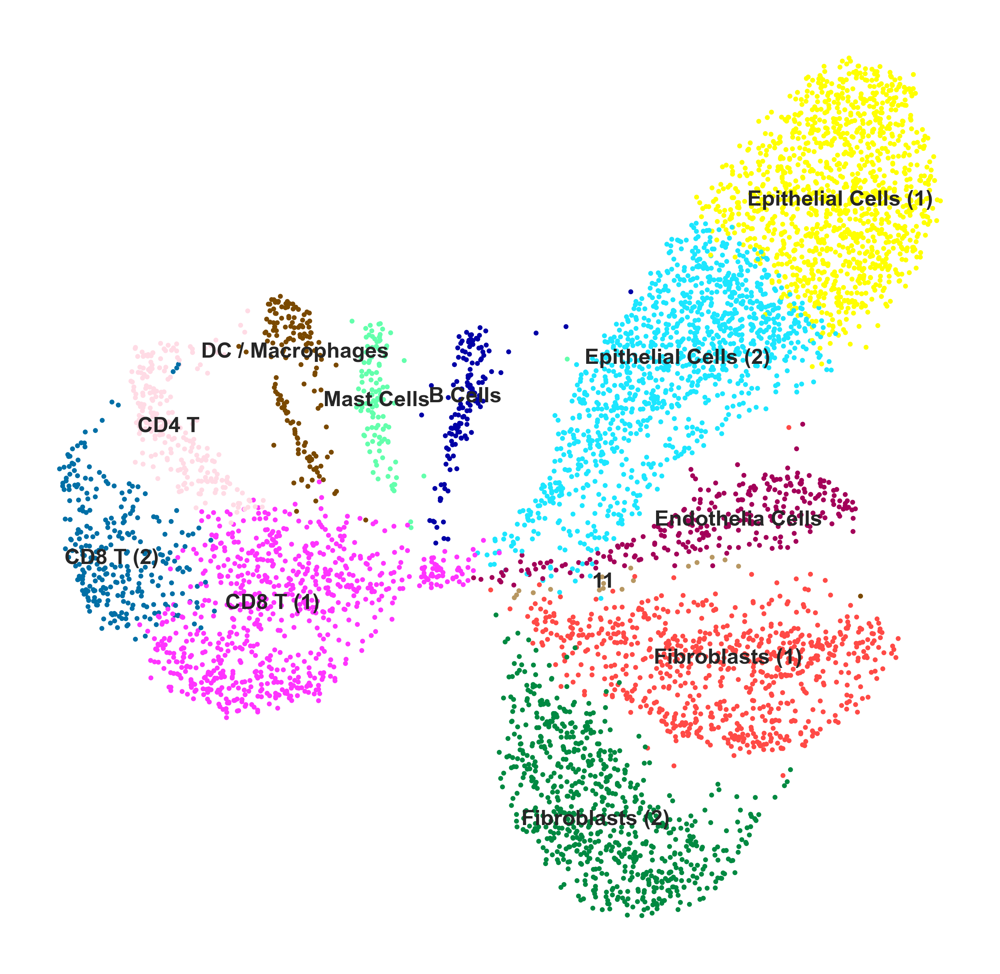

In [62]:
# plt.figure(figsize=(10, 10))
rcParams['figure.figsize'] = 8, 8
sc.pl.umap(all_dataset, color='leiden', legend_loc='on data', legend_fontsize='small', title='', frameon=False, save='.png')

In [63]:
all_dataset

AnnData object with n_obs × n_vars = 5741 × 15741
    obs: 'processed by Maxima enzyme', 'Lymph node', 'classified  as cancer cell', 'classified as non-cancer cells', 'non-cancer cell type', 'sample_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden'
    var: 'n_cells-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'total_counts-1'
    uns: 'pca', 'neighbors', 'umap', 'leiden', 'leiden_colors', 'sample_id_colors', 'rank_genes_groups', 'dendrogram_leiden'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [64]:
all_dataset.write(os.path.join(result_dir, 'all_HNSCC_Puram_Cell_2017_merged_after_batch_correction.h5ad'))

#### Comparing original cell type and annotated cell type

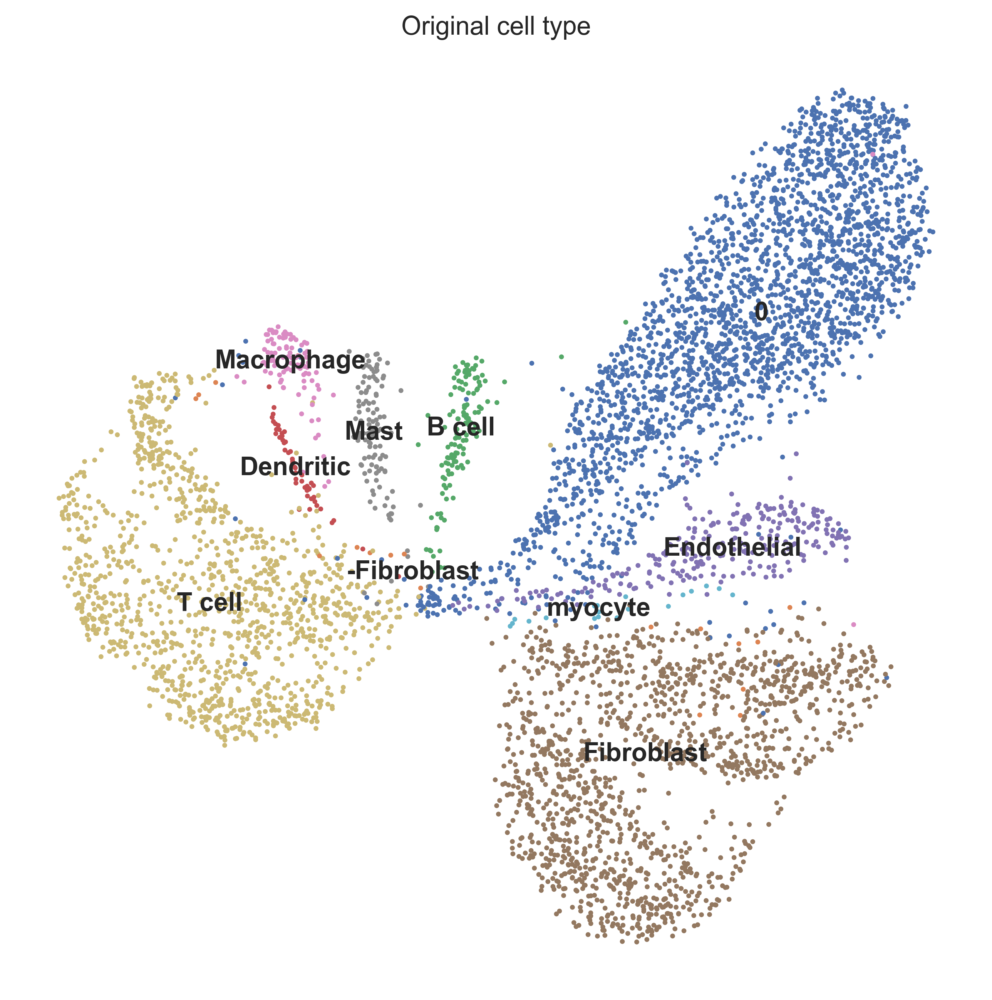

In [65]:
sc.pl.umap(all_dataset, color='non-cancer cell type', legend_loc='on data', legend_fontsize='medium', title='Original cell type', frameon=False, save='literature.png')

In [66]:
cell_type_mapping_leiden = {
 'Fibroblasts (1)': 'Fibroblasts',
 'Fibroblasts (2)': 'Fibroblasts',
 'Epithelial Cells (1)': 'Cancer Cells',
 'Endothelia Cells': 'Endothelial Cells',
 'Epithelial Cells (2)': 'Cancer Cells',
 'B Cells': 'B Cells',
 '11': '11',
 'CD8 T (1)': 'T Cells',
 'CD8 T (2)': 'T Cells',
 'DC / Macrophages': 'Macrophages',
 'Mast Cells': 'Mast Cells',
 'CD4 T': 'T Cells',
}

In [67]:
cell_type_mapping_original = {
 'Fibroblast': 'Fibroblasts',
 '0': 'Cancer Cells',
 'Endothelial': 'Endothelial Cells',
 'B cell': 'B Cells',
 'T cell': 'T Cells',
 'myocyte': 'Myocyte',  # remove later
 'Macrophage': 'Macrophages',
 'Mast': 'Mast Cells',
 'Dendritic': 'DC',
 '-Fibroblast': '-Fibroblast'  # remove later
}

In [68]:
all_dataset.obs['cell_type1'] = all_dataset.obs.leiden.map(cell_type_mapping_leiden)
all_dataset.obs['original_cell_type'] = all_dataset.obs['non-cancer cell type'].map(cell_type_mapping_original)
all_dataset.obs.head(2)

,processed by Maxima enzyme,Lymph node,classified as cancer cell,classified as non-cancer cells,non-cancer cell type,sample_id,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,batch,leiden,cell_type1,original_cell_type
HN28_P15_D06_S330_comb,1,1,0,1,Fibroblast,HN28,4286,4257,998356.1875,0.0,0.0,0,Fibroblasts (2),Fibroblasts,Fibroblasts
HN28_P6_G05_S173_comb,1,0,0,1,Fibroblast,HN28,2723,2712,998954.0000,0.0,0.0,0,Fibroblasts (2),Fibroblasts,Fibroblasts


In [69]:
# setting DC cell type based on original cell type
obs_03 = all_dataset.obs.copy()
dc_bool = (obs_03['cell_type1'] == 'Macrophages') & (obs_03['original_cell_type'] == 'DC')
print(sum(dc_bool))

all_dataset.obs.loc[dc_bool, 'cell_type1'] = 'DC'
all_dataset.obs.leiden = all_dataset.obs.leiden.cat.add_categories(['DC', 'Macrophages'])
all_dataset.obs.loc[dc_bool, 'leiden'] = 'DC'
all_dataset.obs.replace('DC / Macrophages', 'Macrophages', inplace=True)

50


Remove cells with different cell type between `cell_type1` and `original_cell_type`.

In [70]:
hnscc_03_obs_bool = all_dataset.obs['cell_type1'] == all_dataset.obs['original_cell_type']
print(sum(hnscc_03_obs_bool))
all_dataset = all_dataset[hnscc_03_obs_bool, :].copy()

5592


In [71]:
for i, group in all_dataset.obs.groupby(['leiden']):
    n_cell = group.shape[0]
    accuracy = np.sum(group['cell_type1'] == group['original_cell_type']) / n_cell  # annotated same cell type as original cell type
    print(i, round(accuracy, 3), n_cell)

Epithelial Cells (1) 1.0 1214
Epithelial Cells (2) 1.0 1125
CD8 T (1) 1.0 674
Fibroblasts (1) 1.0 714
Fibroblasts (2) 1.0 707
CD8 T (2) 1.0 276
Endothelia Cells 1.0 255
CD4 T 1.0 226
B Cells 1.0 138
Mast Cells 1.0 116
DC 1.0 50
Macrophages 1.0 97


In [72]:
all_dataset.var = all_dataset.var.rename(columns={'n_cells-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0': 'n_cells'})

In [73]:
all_dataset

AnnData object with n_obs × n_vars = 5592 × 15741
    obs: 'processed by Maxima enzyme', 'Lymph node', 'classified  as cancer cell', 'classified as non-cancer cells', 'non-cancer cell type', 'sample_id', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'cell_type1', 'original_cell_type'
    var: 'n_cells', 'total_counts-1'
    uns: 'pca', 'neighbors', 'umap', 'leiden', 'sample_id_colors', 'rank_genes_groups', 'dendrogram_leiden', 'non-cancer cell type_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

... storing 'cell_type1' as categorical


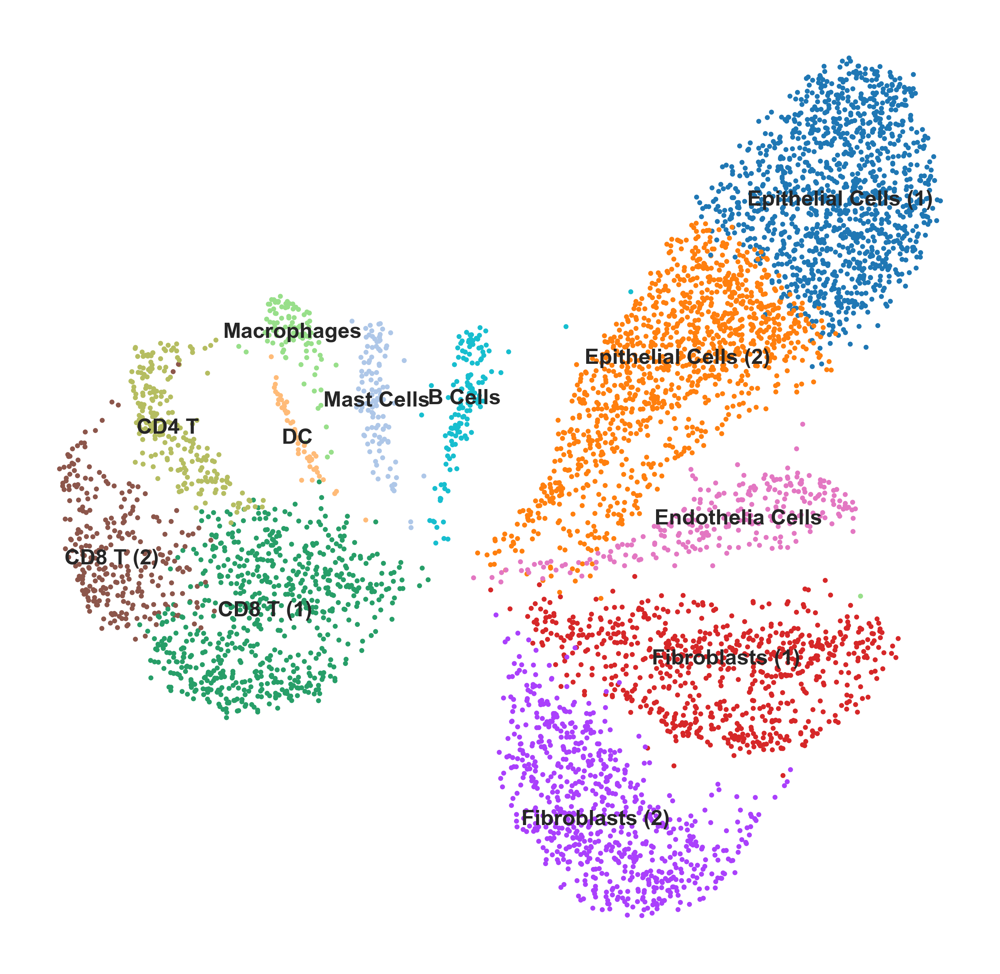

In [74]:
# plt.figure(figsize=(10, 10))
rcParams['figure.figsize'] = 8, 8
sc.pl.umap(all_dataset, color='leiden', legend_loc='on data', legend_fontsize='small', title='', frameon=False, save='_new.png')

In [75]:
all_dataset.write(os.path.join(result_dir, 'all_HNSCC_Puram_Cell_2017_merged_after_batch_correction.h5ad'))